We may want to downsample the data from 1/6 Hz to 1min (i.e. 10x downsampling), or even 15min (which is the paper's setting).

This reduces the episode length of the RL, which may lead to better performance (and shorter training time)

Attempt to use (apply w/out thorough understanding) different ready-made algos to test

First load our created dataset

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from pathlib import Path

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# load the created dataset
dataset_folder_path = Path("dataset", "20250707", "split")

In [4]:
# copied from 03_data_split.ipynb

# Helper functions for the new split folder structure
def load_split_data_from_folder(split_folder, split_type='train'):
    """Load aggregate data from split folder"""
    segments = []
    with open(split_folder / f'{split_type}_segments.txt', 'r') as f:
        for line in f:
            start_str, end_str = line.strip().split(' - ')
            start = datetime.fromisoformat(start_str)
            end = datetime.fromisoformat(end_str)
            segments.append((start, end))
    
    df = pd.read_pickle(split_folder / f'{split_type}_aggregate_df.pkl')
    return segments, df

def load_signatures_from_split_folder(split_folder, split_type, appliance):
    """Load appliance signatures from split folder"""
    sig_path = split_folder / 'load_signature_library' / split_type / appliance / 'load_signatures.pkl'
    ranges_path = split_folder / 'load_signature_library' / split_type / appliance / 'selected_ranges.txt'
    
    if not sig_path.exists():
        return pd.DataFrame(), []
    
    signatures_df = pd.read_pickle(sig_path)
    ranges = []
    if ranges_path.exists():
        with open(ranges_path, 'r') as f:
            for line in f:
                start, end = map(int, line.strip().split(','))
                ranges.append((start, end))
    
    return signatures_df, ranges

In [5]:
aggregate_load_segments, aggregate_load_df = load_split_data_from_folder(dataset_folder_path, 'train')

In [6]:
aggregate_load_df

,timestamp,aggregate,datetime,washing_machine,dishwasher,fridge,kettle,microwave,toaster,tv,htpc,gas_oven,kitchen_lights
0,1.357603e+09,234.0,2013-01-08 00:00:05+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,69.0,NaN,0.0
1,1.357603e+09,231.0,2013-01-08 00:00:11+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,70.0,NaN,0.0
2,1.357603e+09,234.0,2013-01-08 00:00:17+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,70.0,NaN,0.0
3,1.357603e+09,232.0,2013-01-08 00:00:23+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,68.0,NaN,0.0
4,1.357603e+09,232.0,2013-01-08 00:00:30+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,70.0,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2231636,1.388448e+09,178.0,2013-12-30 23:59:35+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,3.0,0.0
2231637,1.388448e+09,177.0,2013-12-30 23:59:41+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,3.0,0.0
2231638,1.388448e+09,178.0,2013-12-30 23:59:47+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,3.0,0.0
2231639,1.388448e+09,178.0,2013-12-30 23:59:53+00:00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,3.0,0.0


In [7]:
aggregate_load_segments

[(datetime.datetime(2013, 1, 8, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 1, 10, 23, 59, 59, 999999, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 2, 27, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 2, 28, 23, 59, 59, 999999, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 3, 8, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 3, 10, 23, 59, 59, 999999, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 3, 28, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 3, 31, 23, 59, 59, 999999, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 3, 22, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 3, 26, 23, 59, 59, 999999, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 4, 8, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 4, 10, 23, 59, 59, 999999, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 4, 26, 0, 0, tzinfo=datetime.timezone.utc),
  d

In [8]:
# break the segments into per-day segments
def break_segments_into_days(segments):
    """Break segments into per-day segments"""
    daily_segments = []
    for start, end in segments:
        current = start
        while current < end:
            next_day = current + timedelta(days=1) - timedelta(milliseconds=1)
            daily_segments.append((current, min(next_day, end)))
            current = next_day + timedelta(milliseconds=1)
    return daily_segments

daily_segments = break_segments_into_days(aggregate_load_segments)

daily_segments

[(datetime.datetime(2013, 1, 8, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 1, 8, 23, 59, 59, 999000, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 1, 9, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 1, 9, 23, 59, 59, 999000, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 1, 10, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 1, 10, 23, 59, 59, 999000, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 2, 27, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 2, 27, 23, 59, 59, 999000, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 2, 28, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 2, 28, 23, 59, 59, 999000, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 3, 8, 0, 0, tzinfo=datetime.timezone.utc),
  datetime.datetime(2013, 3, 8, 23, 59, 59, 999000, tzinfo=datetime.timezone.utc)),
 (datetime.datetime(2013, 3, 9, 0, 0, tzinfo=datetime.timezone.utc),
  datet

In [9]:
# extract the daily aggregate load data from the dataframe
def create_24_hour_sequences(aggregate_load_df, segments):
    """Create 24-hour sequences from aggregate load data"""
    sequences = []
    for start, end in segments:
        day_data = aggregate_load_df[(aggregate_load_df['datetime'] >= start) & (aggregate_load_df['datetime'] <= end)]

        # only keep the timestamp, aggregate, datetime columns
        day_data = day_data[['timestamp', 'aggregate', 'datetime']]

        if not day_data.empty:
            sequences.append(day_data)
    return sequences

daily_sequences = create_24_hour_sequences(aggregate_load_df, daily_segments)

In [10]:
daily_sequences[0]

,timestamp,aggregate,datetime
0,1.357603e+09,234.0,2013-01-08 00:00:05+00:00
1,1.357603e+09,231.0,2013-01-08 00:00:11+00:00
2,1.357603e+09,234.0,2013-01-08 00:00:17+00:00
3,1.357603e+09,232.0,2013-01-08 00:00:23+00:00
4,1.357603e+09,232.0,2013-01-08 00:00:30+00:00
...,...,...,...
13375,1.357690e+09,178.0,2013-01-08 23:59:33+00:00
13376,1.357690e+09,177.0,2013-01-08 23:59:39+00:00
13377,1.357690e+09,178.0,2013-01-08 23:59:46+00:00
13378,1.357690e+09,177.0,2013-01-08 23:59:52+00:00


https://www.reddit.com/r/DSP/comments/bclvkv/i_need_to_downsample_by_8_and_dont_want_to_just/

In the post, a comment mentioned

```
I'm on my phone and can't provide a direct link, but polyphase filters are an efficient way to change sampling rates. They take into account the inefficiencies you mention of straight filtering and interpolation and decimation.

For offline and non-real time applications, it doesn't matter much which approach you do. But when cycles are important, this is a good way to change sample rates.

Richard Lyons has a very good book that covers this topic in a straightforward way, "Understanding Digital Signal Processing."
```

The polyphase filter can be an option for downsampling

Scipy provides a ready-to-use implementation for that.

https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.resample_poly.html

We select 10 sequences for testing. The date is used as the seed to generate 10 idx

In [11]:
np.random.seed(202050714)
selected_indices = np.random.choice(len(daily_sequences), size=10, replace=False)
selected_indices

array([  9,  26,   5,  12,  16, 120,  83, 134,  33,  45])

In [12]:
from scipy.signal import resample_poly

In [13]:
resampled_sequences = {}
down_ratio = 10

for idx in selected_indices:
    sequence = daily_sequences[idx]
    # resample the sequence to 1 minute (10x downsampling)
    resampled_sequence = resample_poly(sequence['aggregate'].values, up=1, down=down_ratio)

    # assume we align the re-sampled sequence to the first timestamp of the original sequence
    # then we step through the original sequence timestamps by 10
    resampled_timestamps = pd.date_range(start=sequence['datetime'].iloc[0].replace(minute=0, second=0), periods=len(resampled_sequence), freq=timedelta(seconds=6 * down_ratio))
    # Convert resampled_timestamps to UNIX timestamp (float) to match the original 'timestamp'
    resampled_unix = resampled_timestamps.astype(np.int64) // 10**9
    resampled_df = pd.DataFrame({
        'timestamp': resampled_unix.astype(float),
        'aggregate': resampled_sequence,
        'datetime': resampled_timestamps
    })

    # Perform an approximate merge to the original df, to align the datetime better
    resampled_df = pd.merge_asof(sequence[['timestamp', 'datetime']], resampled_df, on='timestamp', direction='backward', suffixes=('', '_resampled'))

    resampled_sequences[idx] = resampled_df


In [14]:
resampled_sequences[9]

,timestamp,datetime,aggregate,datetime_resampled
0,1.364515e+09,2013-03-29 00:00:04+00:00,126.476773,2013-03-29 00:00:00+00:00
1,1.364515e+09,2013-03-29 00:00:10+00:00,126.476773,2013-03-29 00:00:00+00:00
2,1.364515e+09,2013-03-29 00:00:16+00:00,126.476773,2013-03-29 00:00:00+00:00
3,1.364515e+09,2013-03-29 00:00:22+00:00,126.476773,2013-03-29 00:00:00+00:00
4,1.364515e+09,2013-03-29 00:00:28+00:00,126.476773,2013-03-29 00:00:00+00:00
...,...,...,...,...
14142,1.364602e+09,2013-03-29 23:59:33+00:00,170.700257,2013-03-29 23:34:00+00:00
14143,1.364602e+09,2013-03-29 23:59:39+00:00,170.700257,2013-03-29 23:34:00+00:00
14144,1.364602e+09,2013-03-29 23:59:45+00:00,170.700257,2013-03-29 23:34:00+00:00
14145,1.364602e+09,2013-03-29 23:59:51+00:00,170.700257,2013-03-29 23:34:00+00:00


Plot and see the difference

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot the original and resampled sequences
def plot_sequences(original, resampled):
    """Plot original and resampled sequences"""
    plt.figure(figsize=(12, 6), dpi=300)
    sns.lineplot(x='datetime', y='aggregate', data=original, label='Original', color='blue')
    sns.lineplot(x='datetime', y='aggregate', data=resampled, label='Resampled', color='pink')
    plt.title('Original vs Resampled Sequence')
    plt.xlabel('Datetime')
    plt.ylabel('Aggregate Load')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

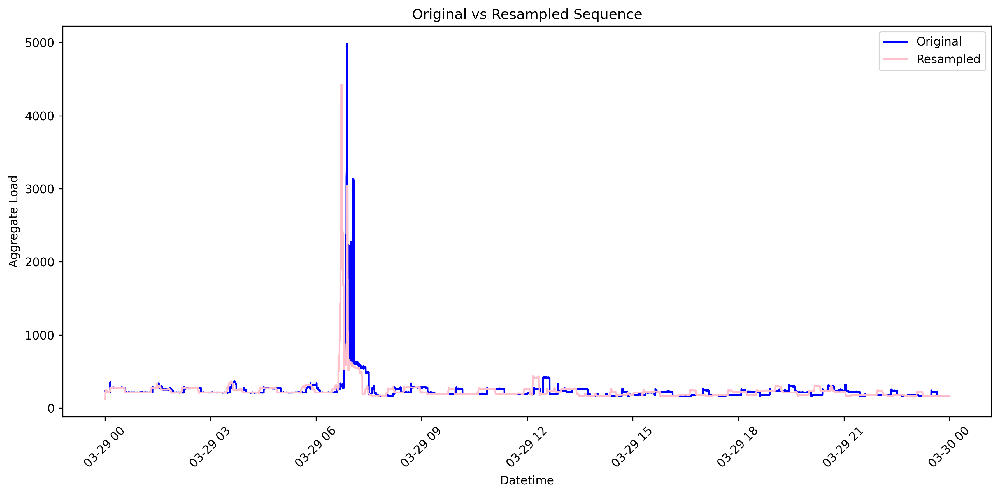

In [63]:
idx = selected_indices[0]
plot_sequences(daily_sequences[idx], resampled_sequences[idx])

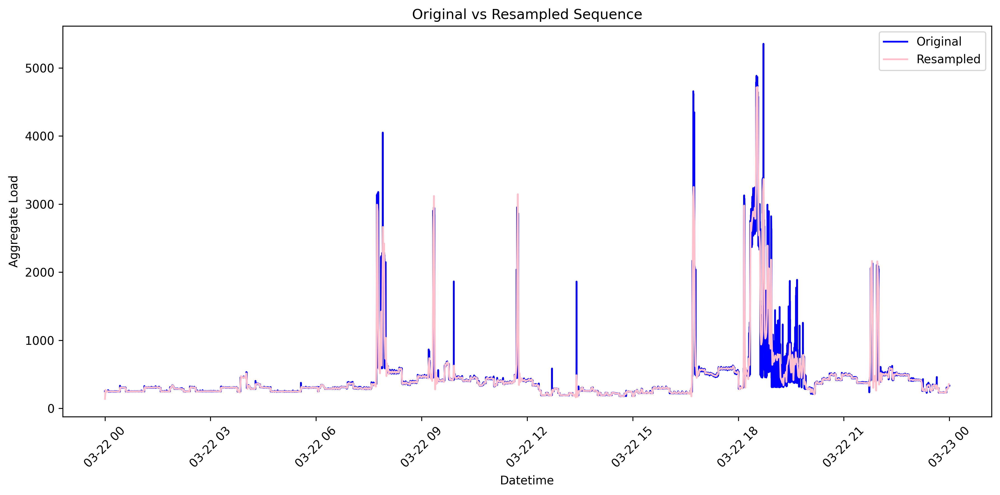

In [67]:
# Interpolate original data to a fixed 6-second interval, then downsample using resample_poly
from scipy.signal import resample_poly

resampled_sequences_uniform = {}
down_ratio = 10  # 1-min = 10 x 6s

for idx in selected_indices:
    sequence = daily_sequences[idx].copy()

    # Create a uniform time grid at 6-second intervals
    start_time = sequence['datetime'].iloc[0]
    end_time = sequence['datetime'].iloc[-1]
    uniform_times = pd.date_range(start=start_time, end=end_time, freq='6s')

    # Interpolate aggregate values to this grid
    # Convert datetime to UNIX timestamp for interpolation
    orig_unix = sequence['datetime'].astype(np.int64) // 10**9
    uniform_unix = uniform_times.astype(np.int64) // 10**9
    uniform_aggregate = np.interp(uniform_unix, orig_unix, sequence['aggregate'].values)

    # Downsample using resample_poly
    resampled_sequence = resample_poly(uniform_aggregate, up=1, down=down_ratio)

    # Get the corresponding resampled times
    resampled_times = uniform_times[::down_ratio][:len(resampled_sequence)]

    resampled_df = pd.DataFrame({
        'datetime': resampled_times,
        'aggregate': resampled_sequence,
        'timestamp': resampled_times.astype(np.int64) // 10**9
    })

    resampled_sequences_uniform[idx] = resampled_df

# Example: plot the first sequence
idx = selected_indices[3]
plot_sequences(daily_sequences[idx], resampled_sequences_uniform[idx])


---

In [18]:
def plot_sequences_2(original, resampled, filter_type, filter_order):
    """Plot original and resampled sequences with filter type and order"""
    plt.figure(figsize=(12, 6), dpi=300)
    sns.lineplot(x='datetime', y='aggregate', data=original, label='Original', color='blue')
    sns.lineplot(x='datetime', y='aggregate', data=resampled, label=f'Resampled ({filter_type})', color='pink')
    plt.title(f'Original vs Resampled Sequence (Filter: {filter_type}, Order: {filter_order})')
    plt.xlabel('Datetime')
    plt.ylabel('Aggregate Load')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [15]:
# Downsampling with user-selectable low-pass filter (LPF) and alignment to original data, avoiding linear interpolation
import numpy as np
import pandas as pd
from scipy.signal import firwin, butter, cheby1, cheby2, ellip, bessel, lfilter, filtfilt
import matplotlib.pyplot as plt
import seaborn as sns

# --- User options ---
filter_type = 'fir'  # Options: 'fir', 'butter', 'cheby1', 'cheby2', 'ellip', 'bessel'
filter_order = 6   # For FIR, must be odd; for IIR, typical 4-8

cutoff_hz = 1/60     # 1/minute, Nyquist = 1/6 Hz, so cutoff < 1/12 Hz
zero_phase = True    # Use filtfilt (zero-phase) or lfilter (causal)
down_ratio = 10      # Downsample from 1/6 Hz to 1/60 Hz (1 min)

# --- Helper: Design filter ---
def design_lpf(filter_type, order, cutoff, fs):
    if filter_type == 'fir':
        taps = firwin(order, cutoff/(fs/2), window='hamming')
        return taps, [1.0]
    elif filter_type == 'butter':
        b, a = butter(order, cutoff/(fs/2), btype='low')
        return b, a
    elif filter_type == 'cheby1':
        b, a = cheby1(order, 1, cutoff/(fs/2), btype='low')
        return b, a
    elif filter_type == 'cheby2':
        b, a = cheby2(order, 20, cutoff/(fs/2), btype='low')
        return b, a
    elif filter_type == 'ellip':
        b, a = ellip(order, 0.5, 20, cutoff/(fs/2), btype='low')
        return b, a
    elif filter_type == 'bessel':
        b, a = bessel(order, cutoff/(fs/2), btype='low', norm='phase')
        return b, a
    else:
        raise ValueError('Unknown filter type')

def downsample_with_lpf(selected_indices, daily_sequences, filter_type='fir', filter_order=7, cutoff_hz=1/60, zero_phase=True, down_ratio=10, fs=1/6):
    """
    Downsample daily_sequences at selected_indices using a user-selectable low-pass filter.
    Returns:
        uniform_aggregate_sequences: dict of idx -> uniform aggregate np.ndarray
        resampled_sequences_lpf: dict of idx -> DataFrame with columns ['datetime', 'aggregate', 'timestamp']
    """
    uniform_aggregate_sequences = {}
    filtered_seqs = {}
    resampled_sequences_lpf = {}

    for idx in selected_indices:
        sequence = daily_sequences[idx].copy()
        # Create a uniform 6s grid covering the original data
        start_time = sequence['datetime'].iloc[0]
        end_time = sequence['datetime'].iloc[-1]
        uniform_times = pd.date_range(start=start_time, end=end_time, freq='6s')
        # Use nearest-neighbor reindexing to avoid interpolation
        sequence_nn = sequence.set_index('datetime').reindex(uniform_times, method='nearest').reset_index()
        sequence_nn.rename(columns={'index': 'datetime'}, inplace=True)
        uniform_aggregate = sequence_nn['aggregate'].values
        uniform_aggregate_sequences[idx] = uniform_aggregate

        # Design filter
        b, a = design_lpf(filter_type, filter_order, cutoff_hz, fs)
        # Apply filter
        if zero_phase:
            filtered = filtfilt(b, a, uniform_aggregate)
        else:
            filtered = lfilter(b, a, uniform_aggregate)

        filtered_seqs[idx] = filtered

        # Downsample
        resampled_sequence = filtered[::down_ratio]
        resampled_times = uniform_times[::down_ratio][:len(resampled_sequence)]
        resampled_df = pd.DataFrame({

            'datetime': resampled_times,
            'aggregate': resampled_sequence,
            'timestamp': resampled_times.astype(np.int64) // 10**9
        })
        resampled_sequences_lpf[idx] = resampled_df

    return uniform_aggregate_sequences, filtered_seqs, resampled_sequences_lpf



In [27]:
# Example usage:
uniform_aggregate_sequences_fir, filtered_seqs_fir, resampled_sequences_lpf_fir = downsample_with_lpf(
    selected_indices,
    daily_sequences,
    filter_type='fir',
    filter_order=19,
    cutoff_hz=cutoff_hz,
    zero_phase=zero_phase,
    down_ratio=down_ratio,
    fs=1/6  # Original data frequency (approximately 6 seconds per sample)
)

In [15]:
uniform_aggregate_sequences_cheby1, filtered_seqs_cheby1, resampled_sequences_lpf_cheby1 = downsample_with_lpf(
    selected_indices,
    daily_sequences,
    filter_type='cheby1',
    filter_order=6,
    cutoff_hz=cutoff_hz,
    zero_phase=zero_phase,
    down_ratio=down_ratio,
    fs=1/6  # Original data frequency (approximately 6 seconds per sample)
)

In [20]:
uniform_aggregate_sequences_cheby2, filtered_seqs_cheby2, resampled_sequences_lpf_cheby2 = downsample_with_lpf(
    selected_indices,
    daily_sequences,
    filter_type='cheby2',
    filter_order=6,
    cutoff_hz=cutoff_hz,
    zero_phase=zero_phase,
    down_ratio=down_ratio,
    fs=1/6  # Original data frequency (approximately 6 seconds per sample)
)

In [22]:
uniform_aggregate_sequences_ellip, filtered_seqs_ellip, resampled_sequences_lpf_ellip = downsample_with_lpf(
    selected_indices,
    daily_sequences,
    filter_type='ellip',
    filter_order=6,
    cutoff_hz=cutoff_hz,
    zero_phase=zero_phase,
    down_ratio=down_ratio,
    fs=1/6  # Original data frequency (approximately 6 seconds per sample)
)

In [16]:
uniform_aggregate_sequences_bessel, filtered_seqs_bessel, resampled_sequences_lpf_bessel = downsample_with_lpf(
    selected_indices,
    daily_sequences,
    filter_type='bessel',
    filter_order=10,
    cutoff_hz=cutoff_hz,
    zero_phase=zero_phase,
    down_ratio=down_ratio,
    fs=1/6  # Original data frequency (approximately 6 seconds per sample)
)

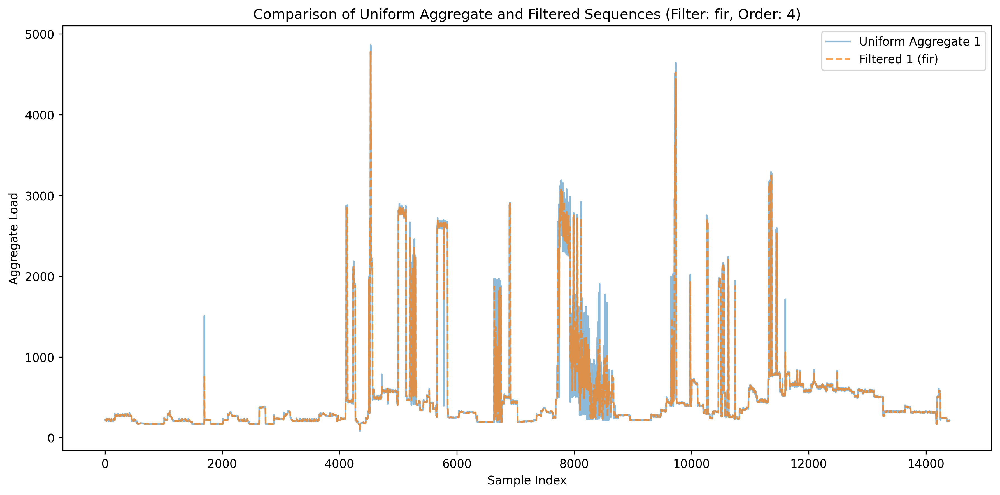

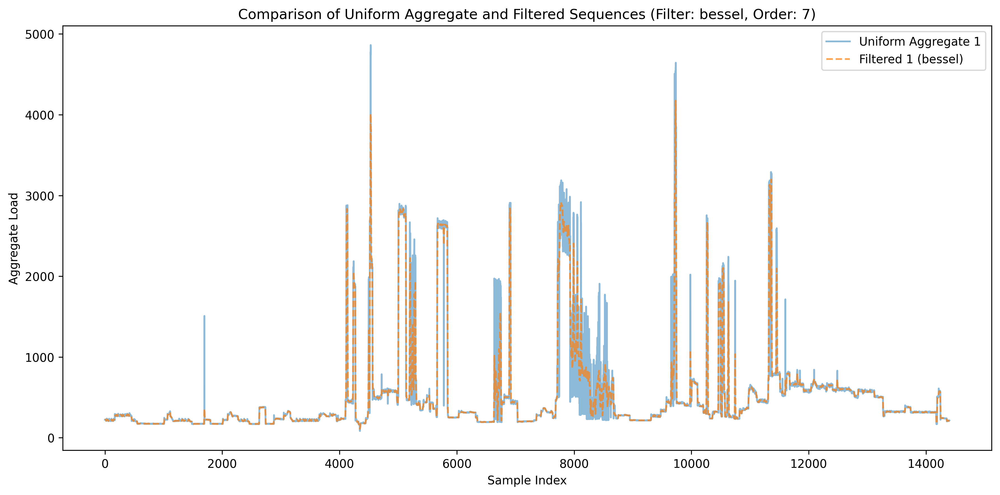

In [17]:
# comparet the uniform aggregate sequences, and the filtered sequences
# to see how the filter affects the data
def plot_comparison(uniform_aggregate_sequences, filtered_seqs, filter_type, filter_order, idx):
    """Plot comparison of uniform aggregate sequences and filtered sequences"""
    selected_idx = selected_indices[idx]

    plt.figure(figsize=(12, 6), dpi=300)
    sns.lineplot(x=np.arange(len(uniform_aggregate_sequences[selected_idx])), y=uniform_aggregate_sequences[selected_idx], label=f'Uniform Aggregate {idx}', alpha=0.5)
    sns.lineplot(x=np.arange(len(filtered_seqs[selected_idx])), y=filtered_seqs[selected_idx], label=f'Filtered {idx} ({filter_type})', linestyle='--', alpha=0.7)

    plt.title(f'Comparison of Uniform Aggregate and Filtered Sequences (Filter: {filter_type}, Order: {filter_order})')
    plt.xlabel('Sample Index')
    plt.ylabel('Aggregate Load')
    plt.legend()
    plt.tight_layout()
    plt.show()

idx = 1
plot_comparison(uniform_aggregate_sequences_fir, filtered_seqs_fir, filter_type='fir', filter_order=4, idx=idx)
plot_comparison(uniform_aggregate_sequences_bessel, filtered_seqs_bessel, filter_type='bessel', filter_order=7, idx=idx)

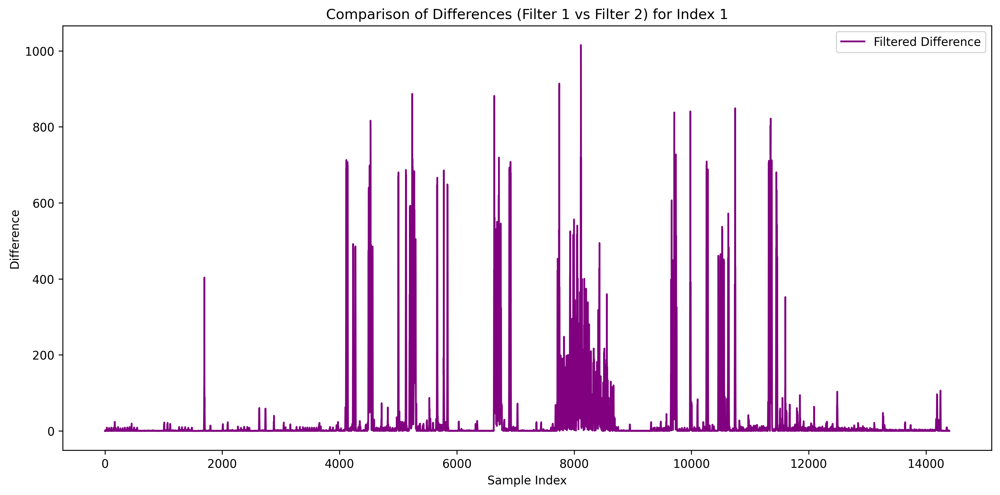

In [18]:
# perform np numerical operations to compare the uniform aggregate sequences and filtered sequences of two different filters
def compare_sequences(uniform_aggregate_sequences1, uniform_aggregate_sequences2, filtered_seqs1, filtered_seqs2, idx):
    """Compare uniform aggregate sequences and filtered sequences of two different filters"""
    selected_idx = selected_indices[idx]

    # Calculate differences
    # uniform_diff = np.abs(uniform_aggregate_sequences1[selected_idx] - uniform_aggregate_sequences2[selected_idx])
    filtered_diff = np.abs(filtered_seqs1[selected_idx] - filtered_seqs2[selected_idx])

    # Plot comparison
    plt.figure(figsize=(12, 6), dpi=300)
    # sns.lineplot(x=np.arange(len(uniform_diff)), y=uniform_diff, label='Uniform Aggregate Difference', color='blue')
    sns.lineplot(x=np.arange(len(filtered_diff)), y=filtered_diff, label='Filtered Difference', color='purple')

    plt.title(f'Comparison of Differences (Filter 1 vs Filter 2) for Index {idx}')
    plt.xlabel('Sample Index')
    plt.ylabel('Difference')
    plt.legend()
    plt.tight_layout()
    plt.show()

compare_sequences(uniform_aggregate_sequences_fir, uniform_aggregate_sequences_bessel, filtered_seqs_fir, filtered_seqs_bessel, idx=1)


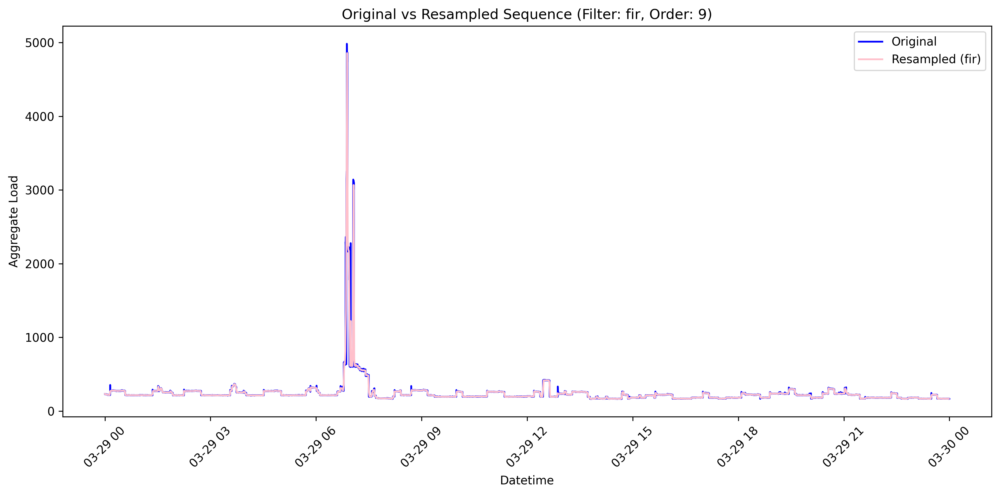

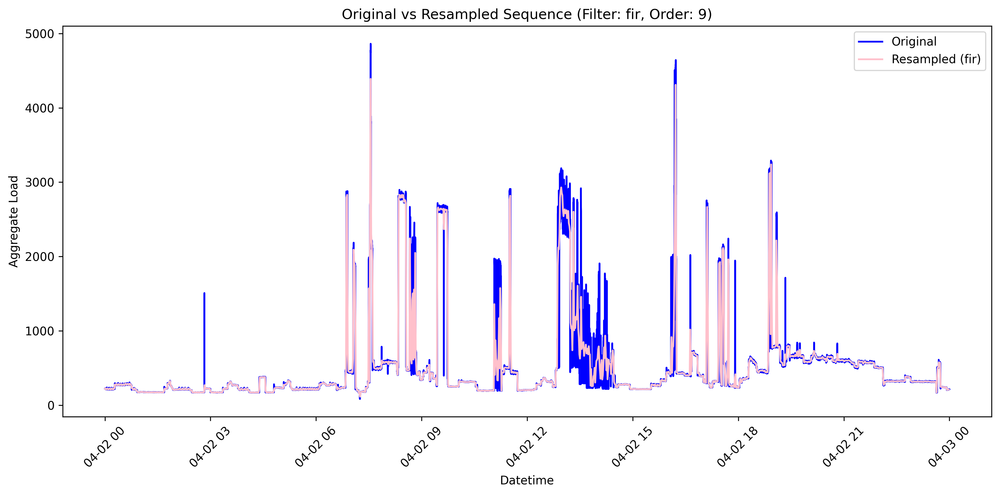

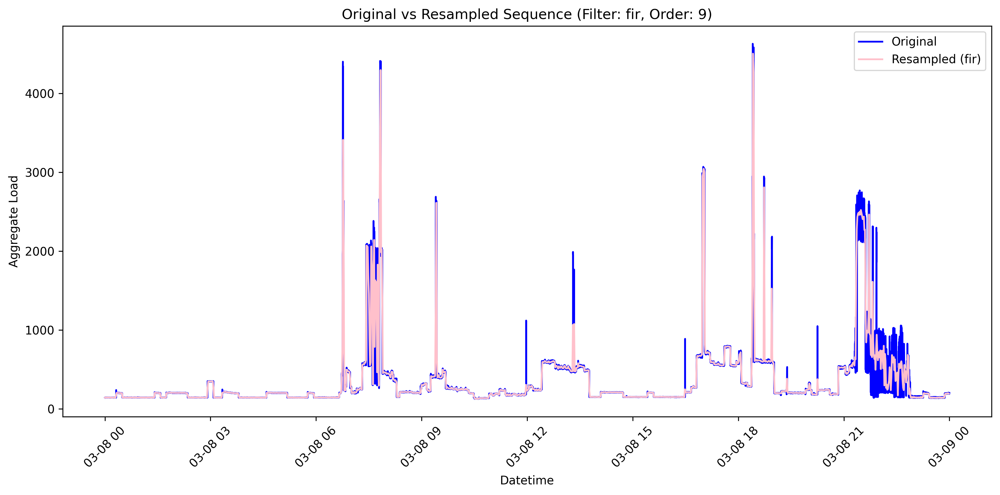

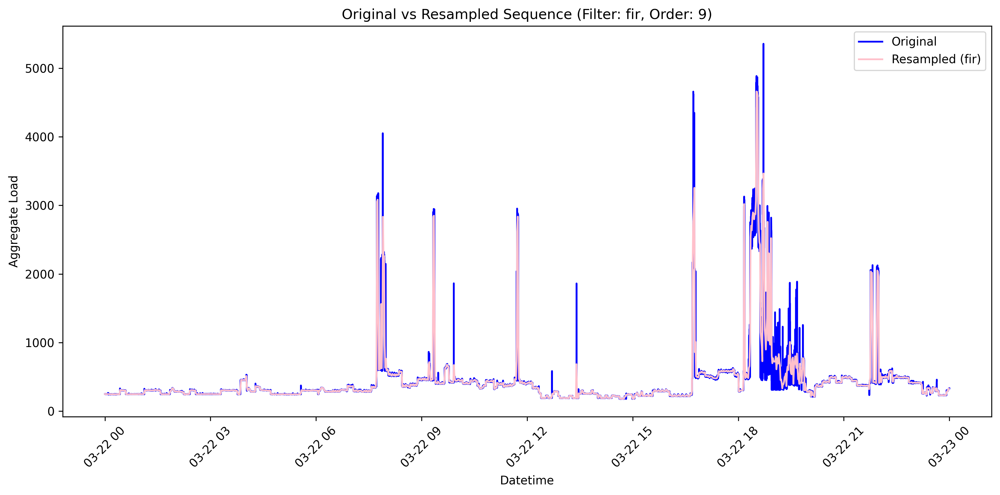

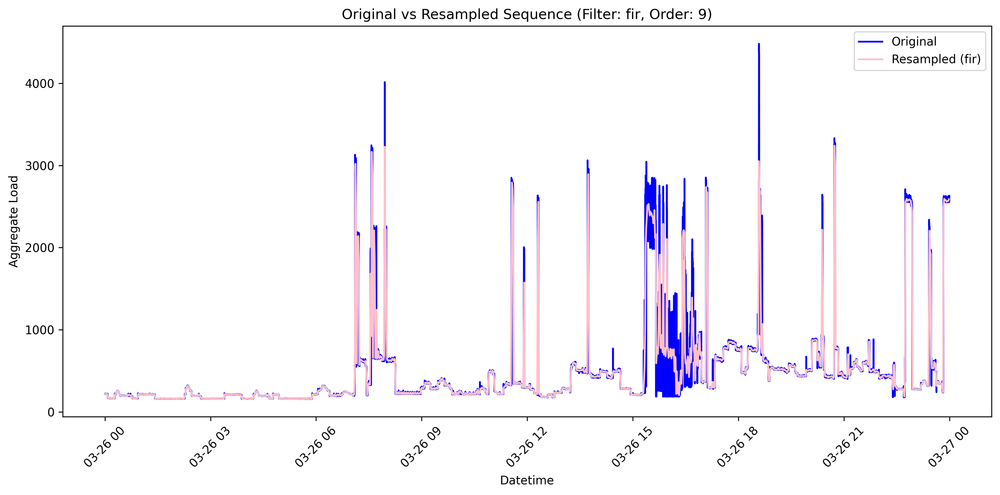

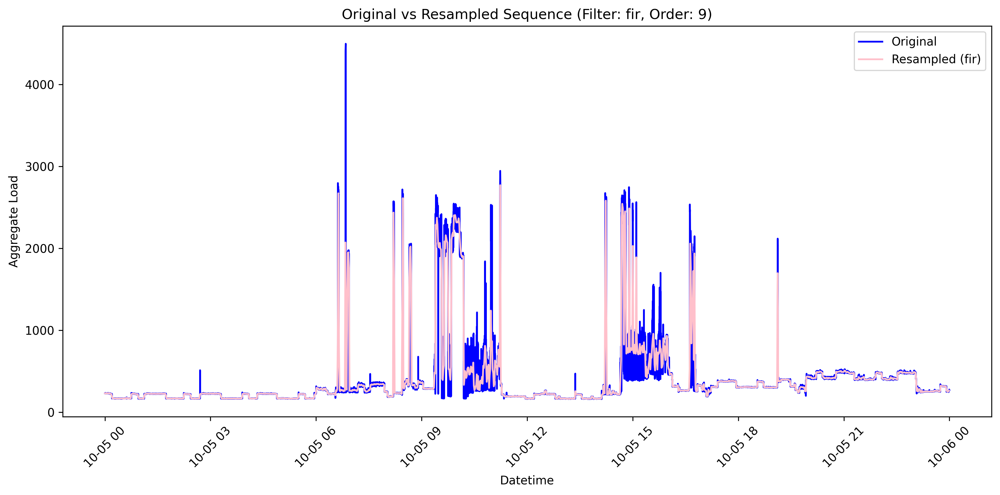

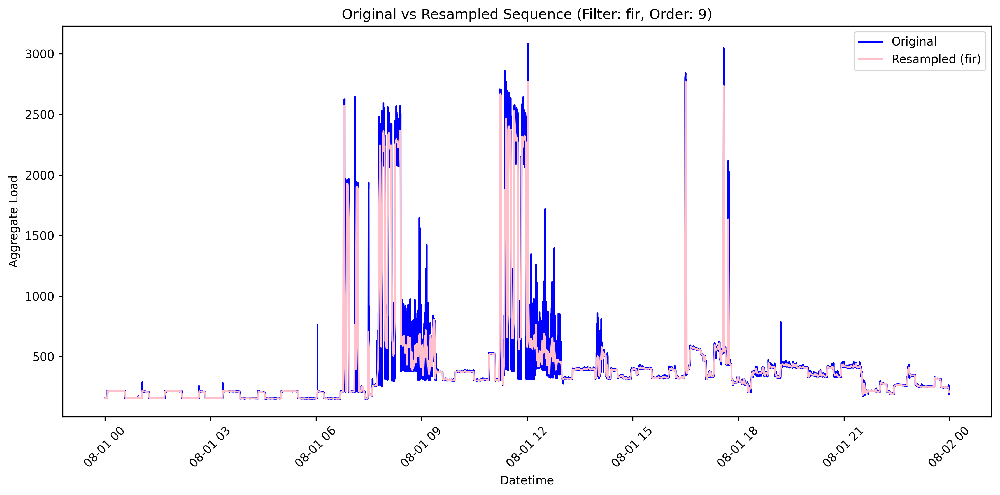

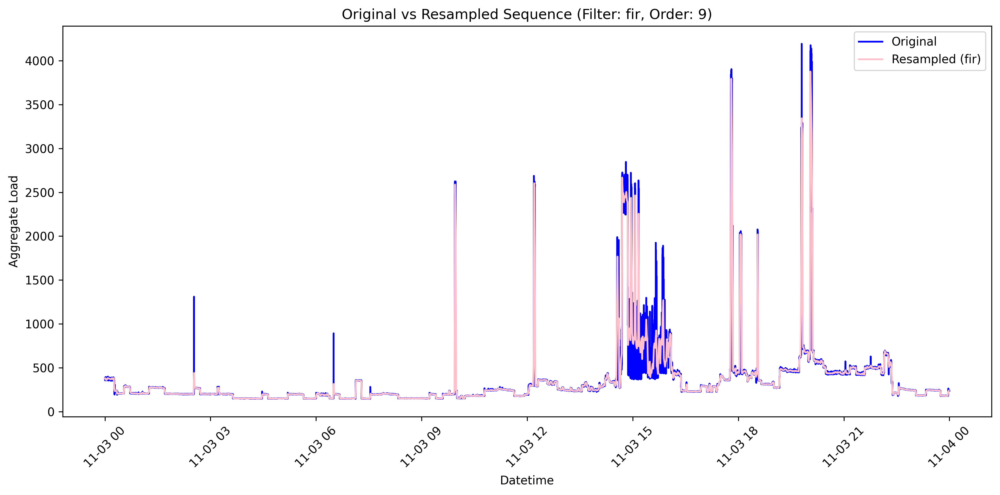

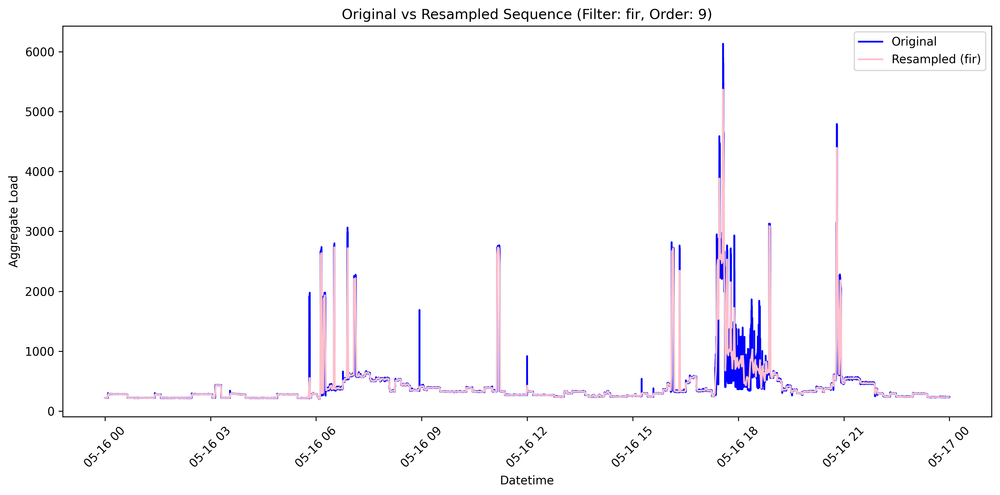

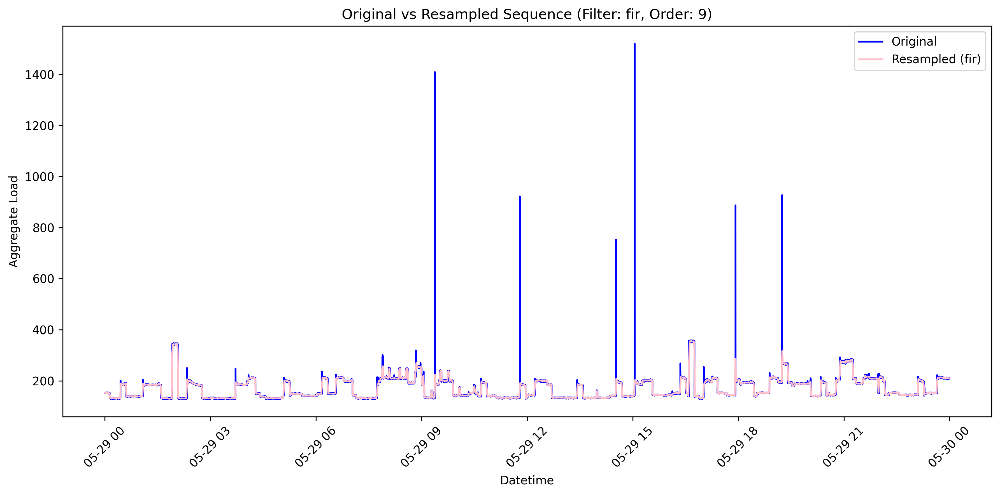

In [26]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_fir[idx], 'fir', 9)

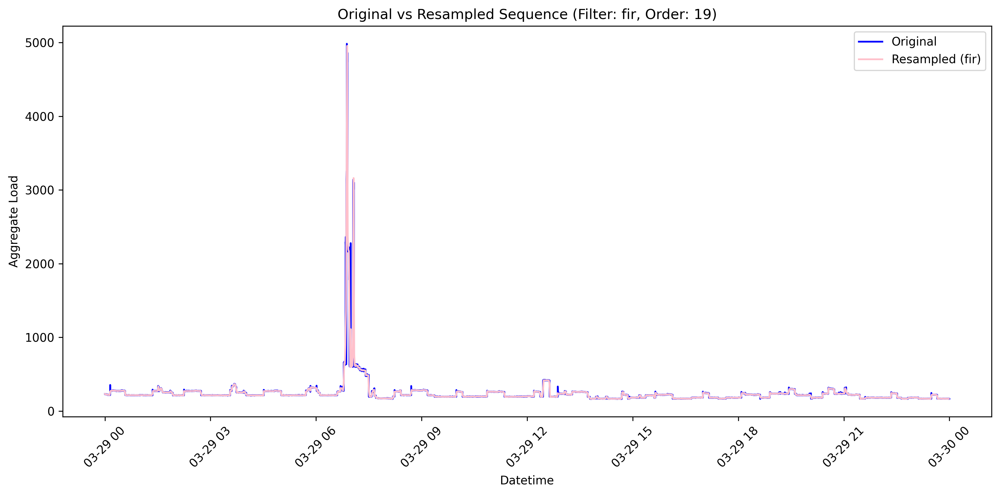

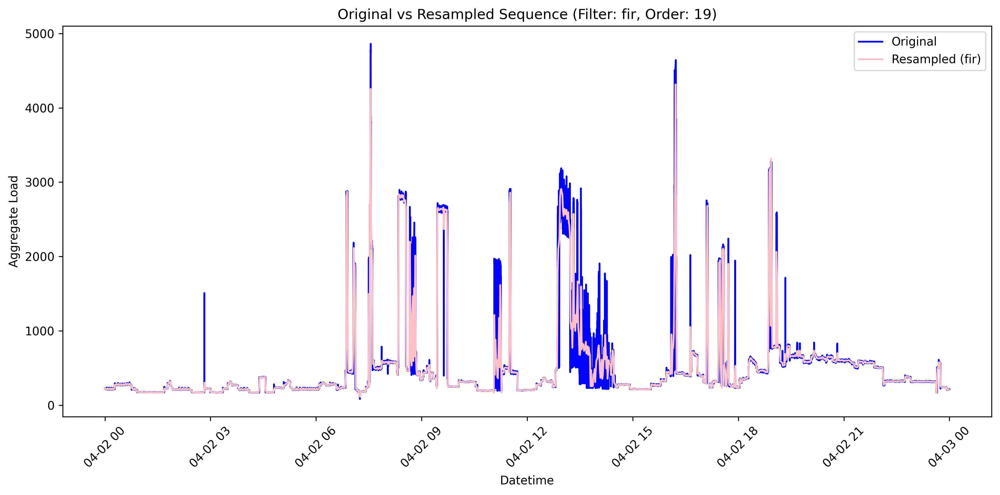

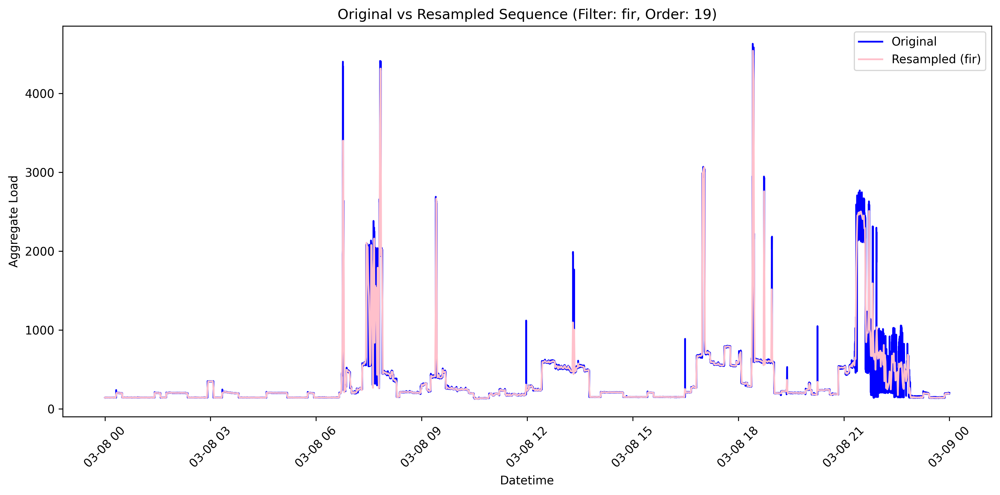

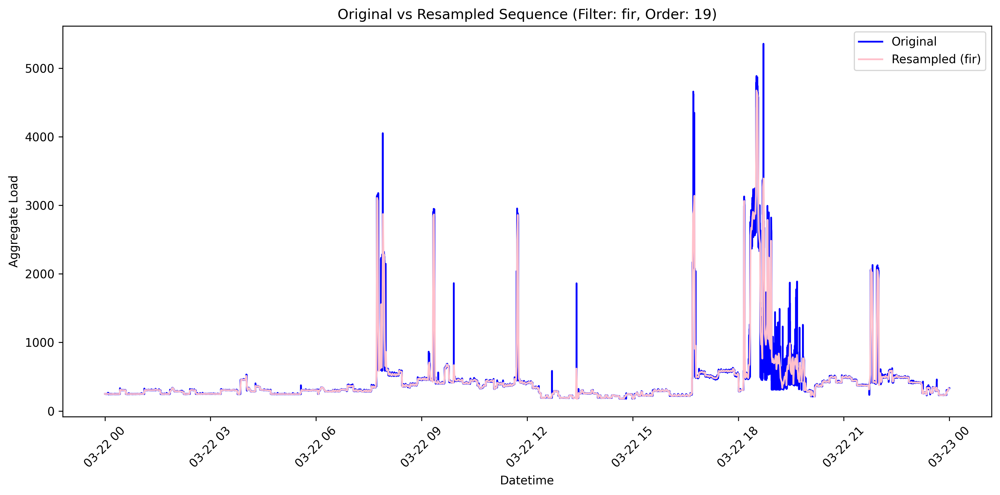

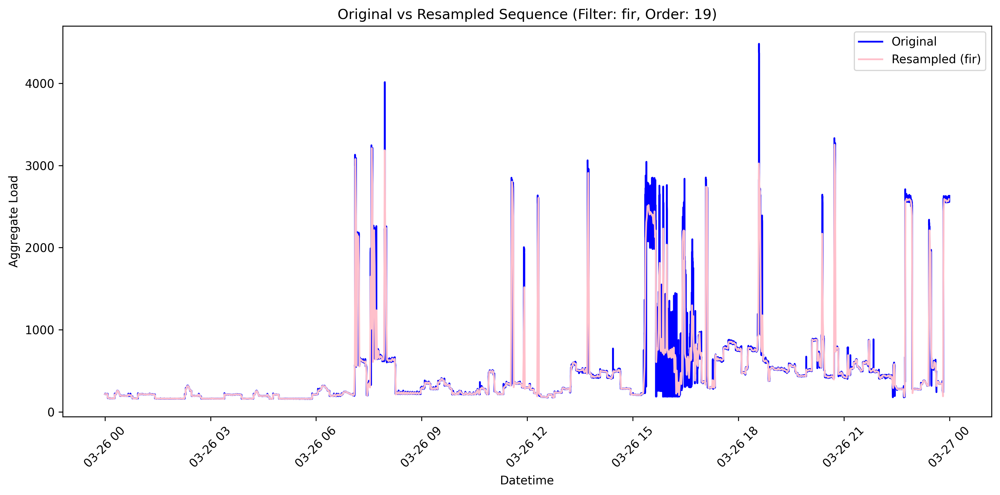

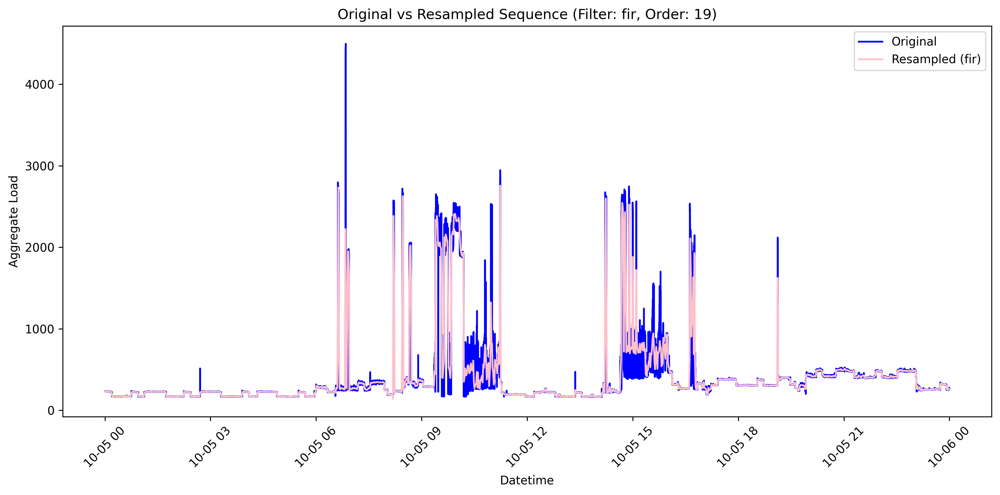

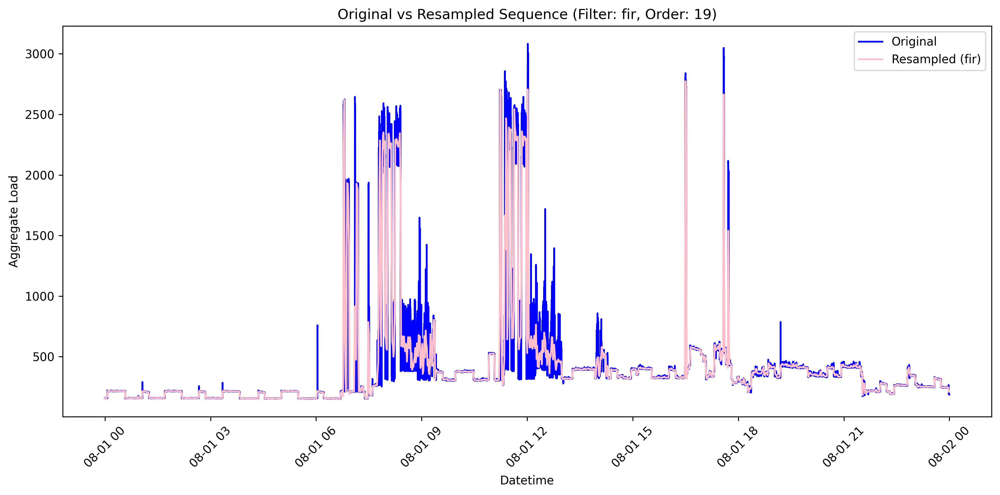

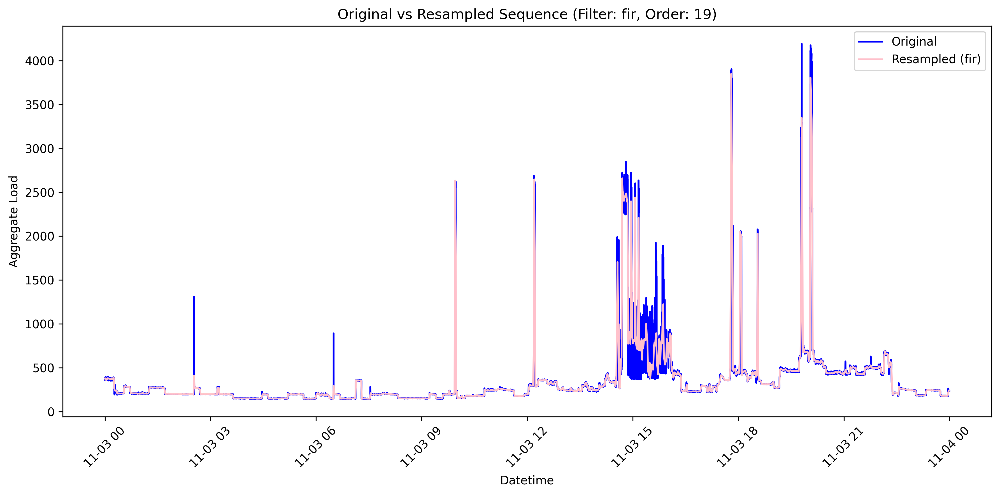

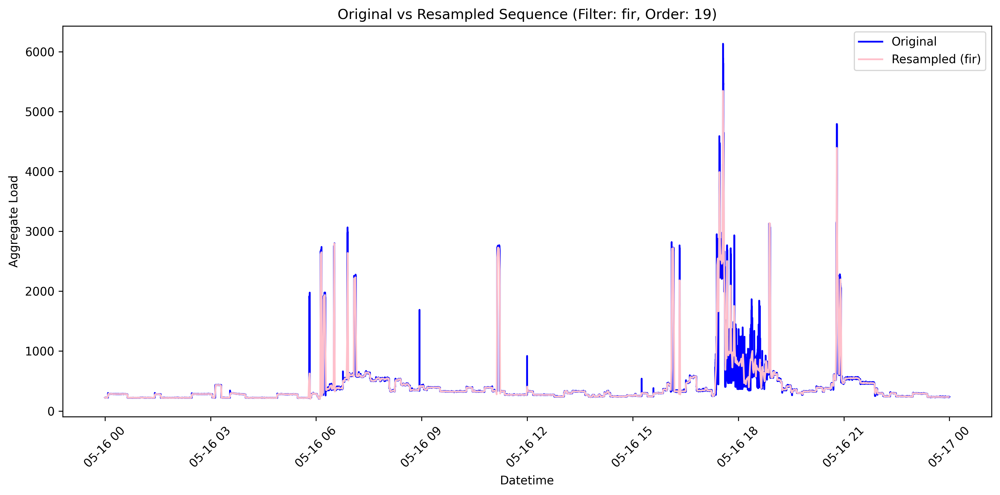

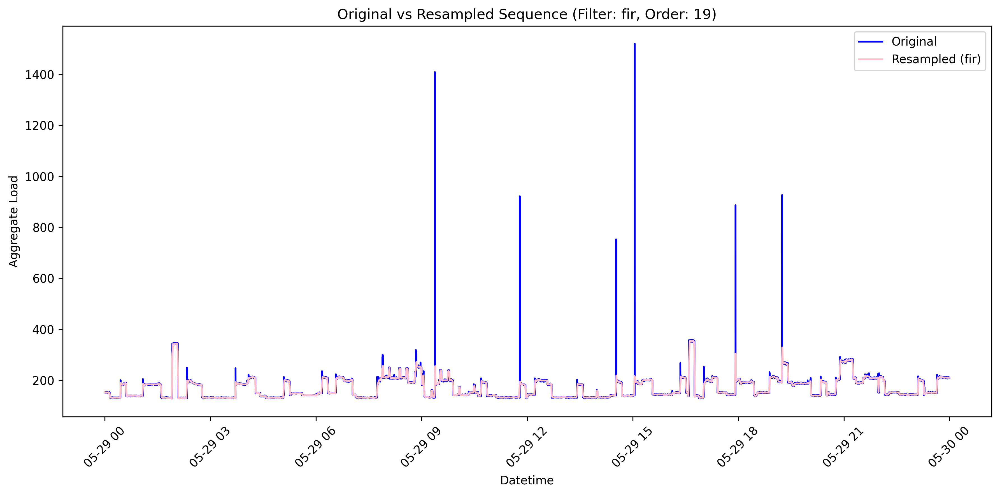

In [28]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_fir[idx], 'fir', 19)

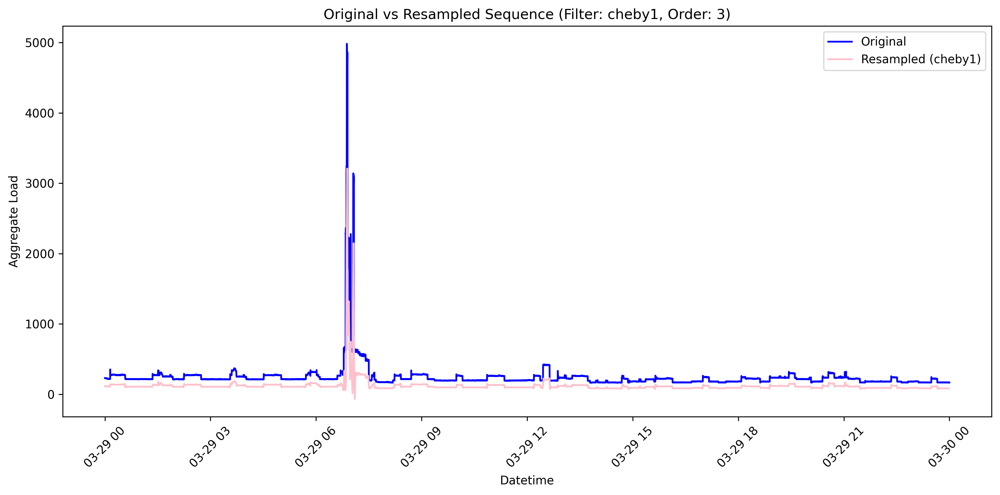

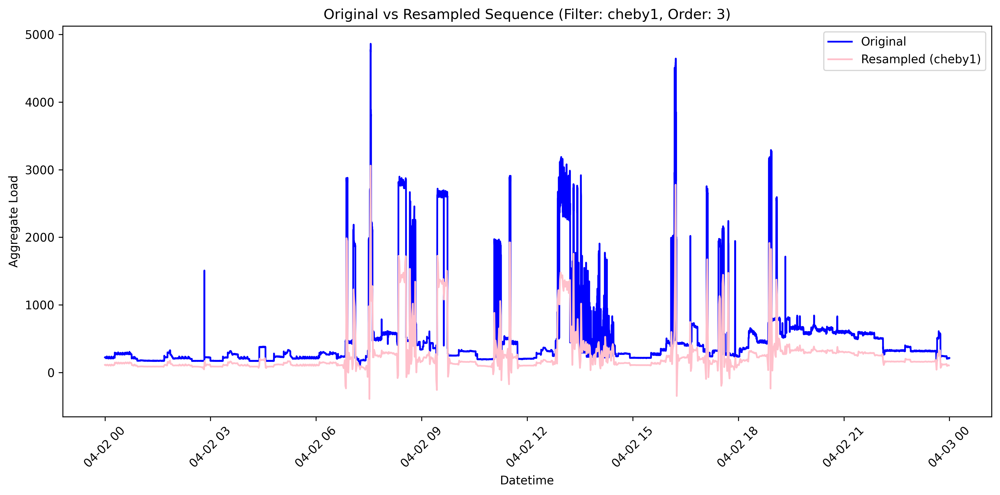

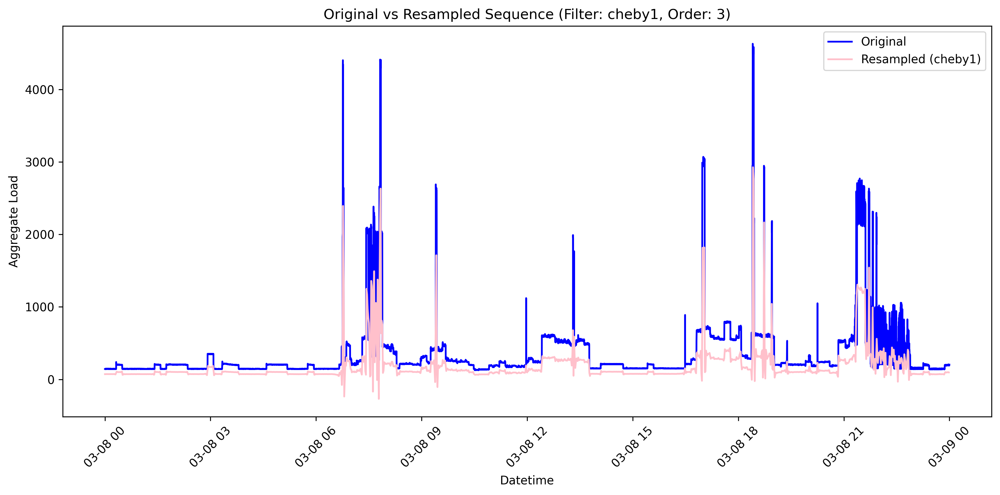

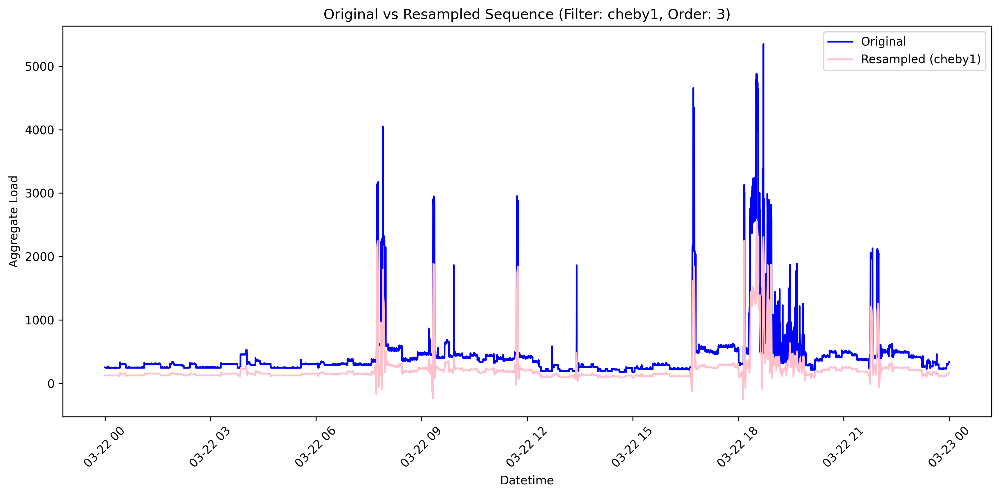

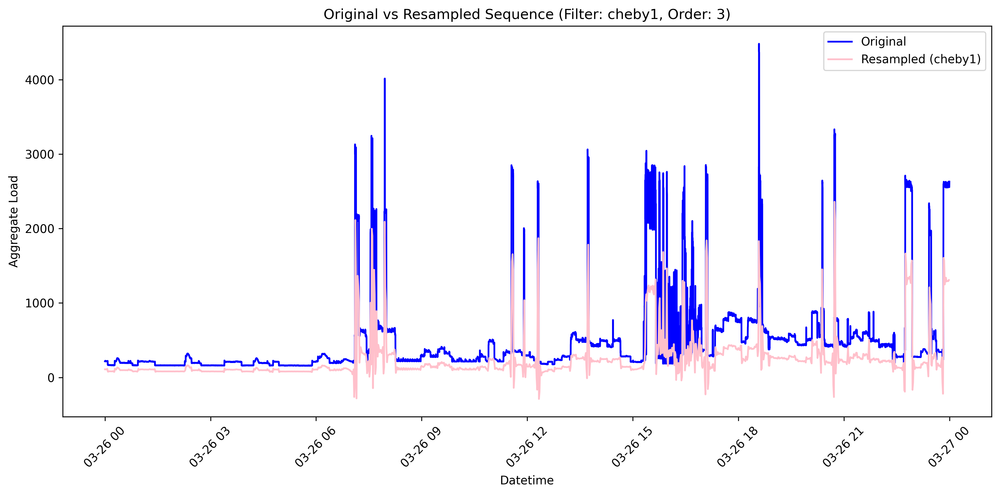

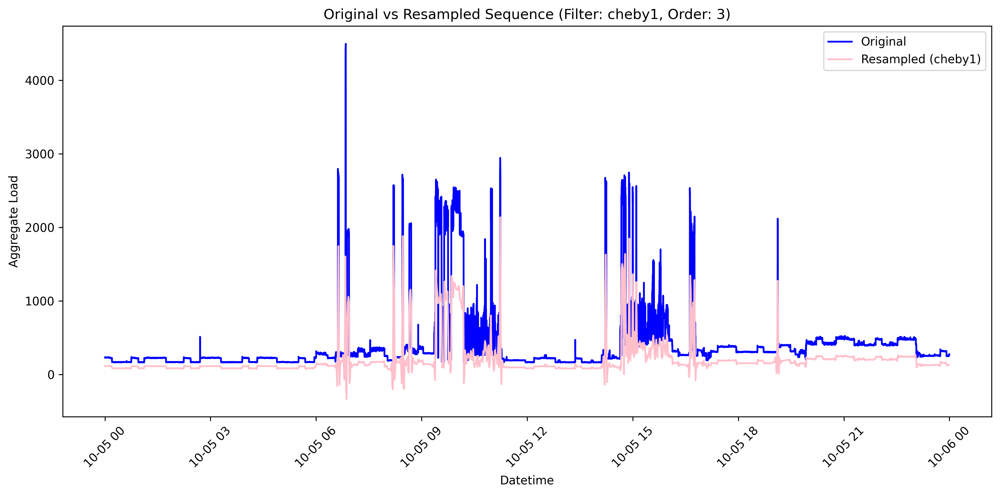

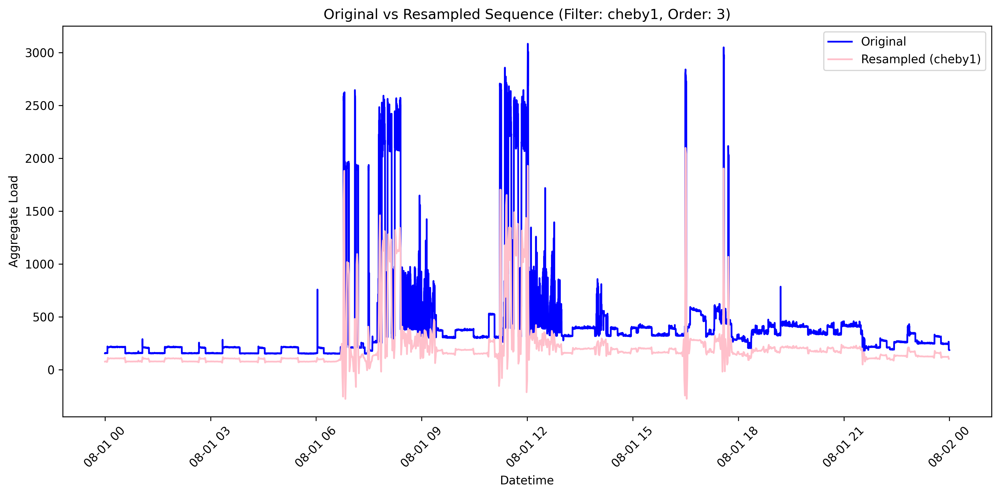

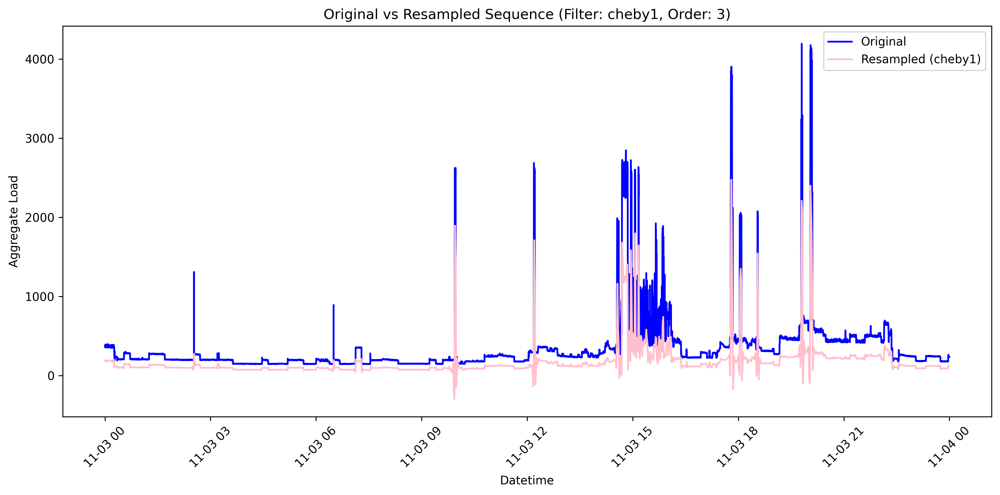

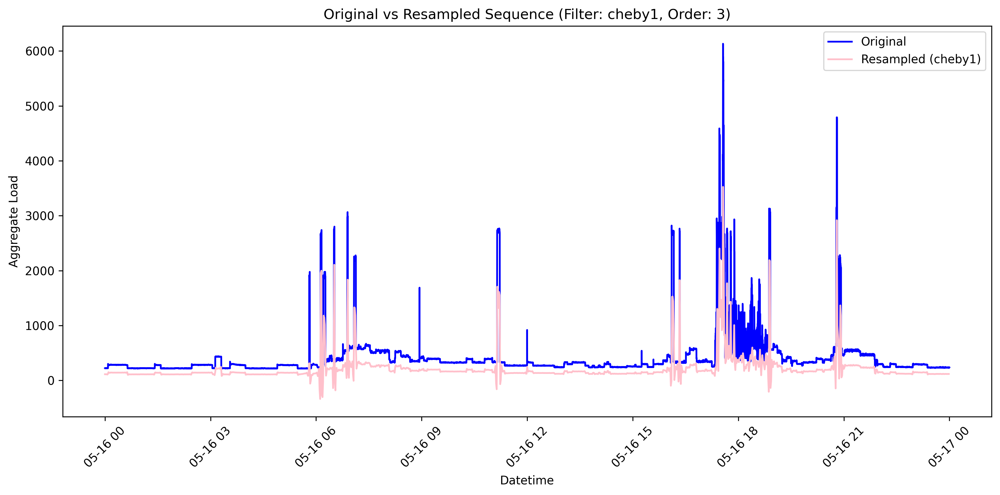

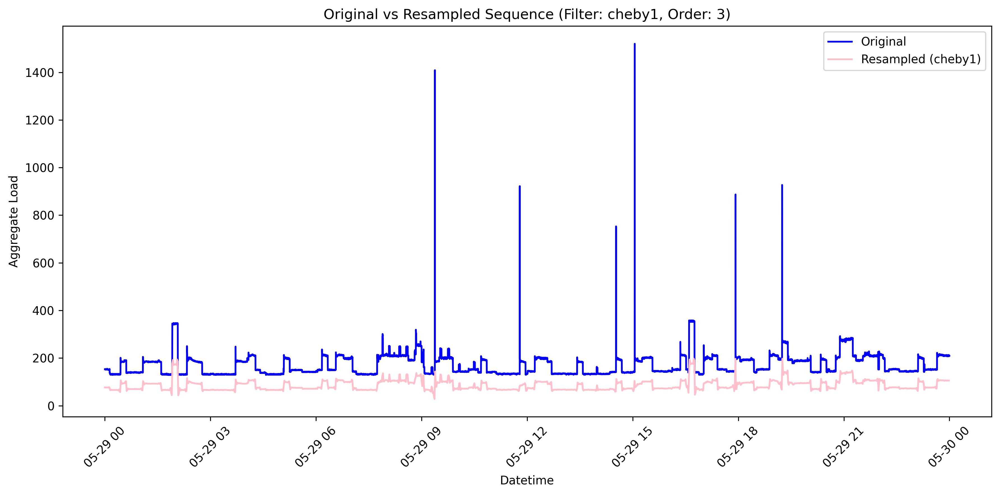

In [19]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_cheby1[idx], 'cheby1', 3)

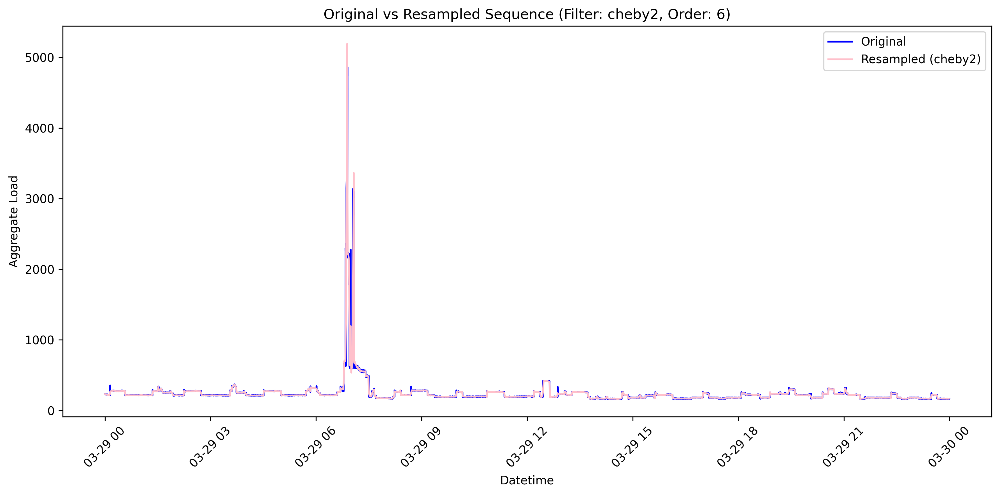

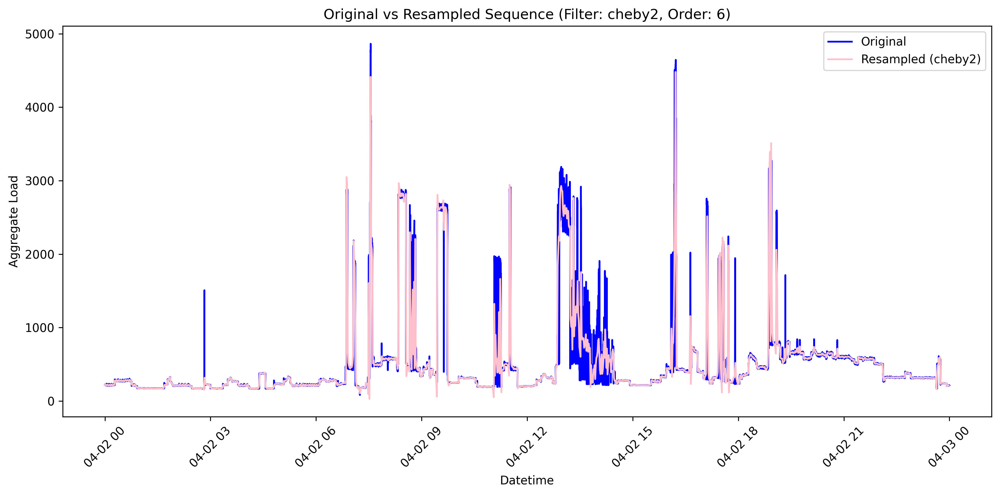

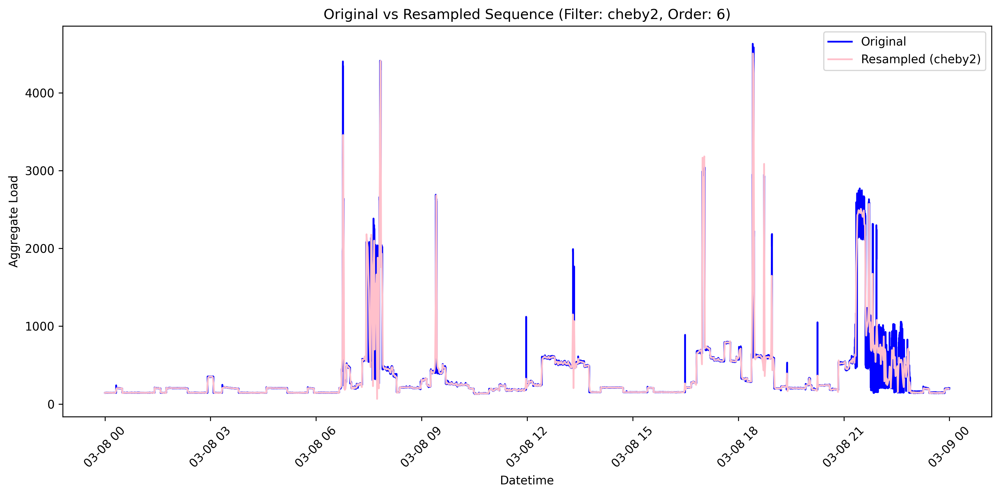

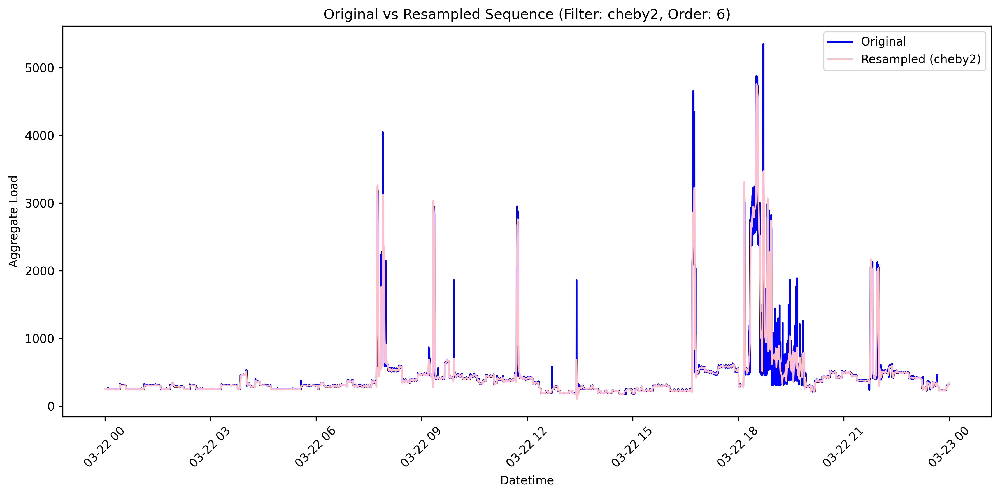

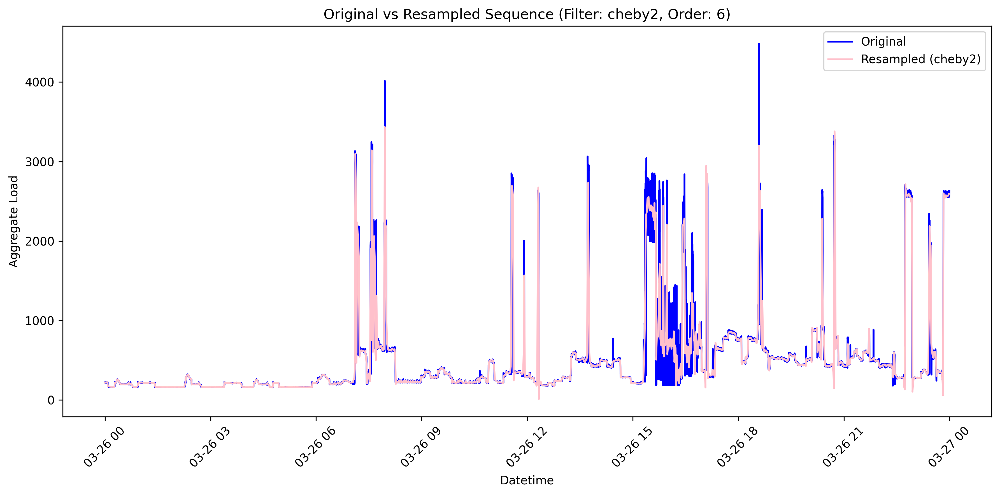

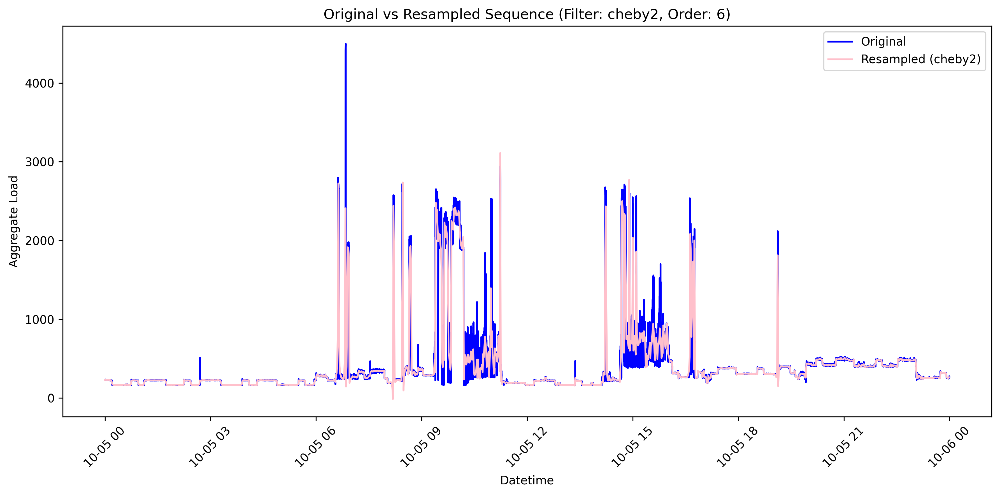

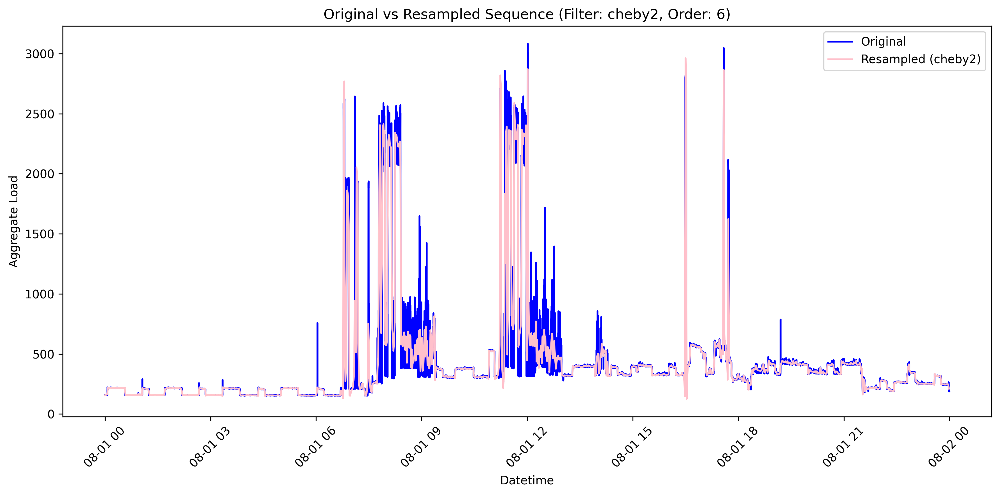

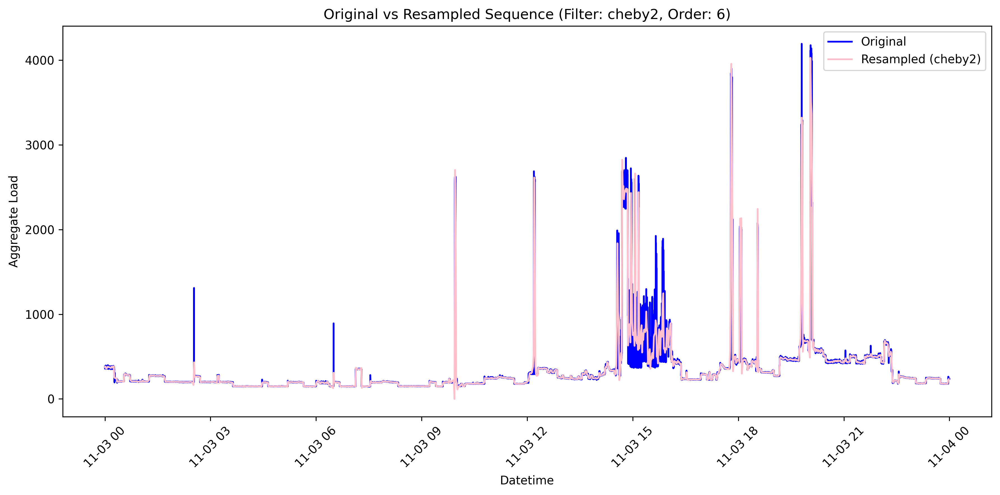

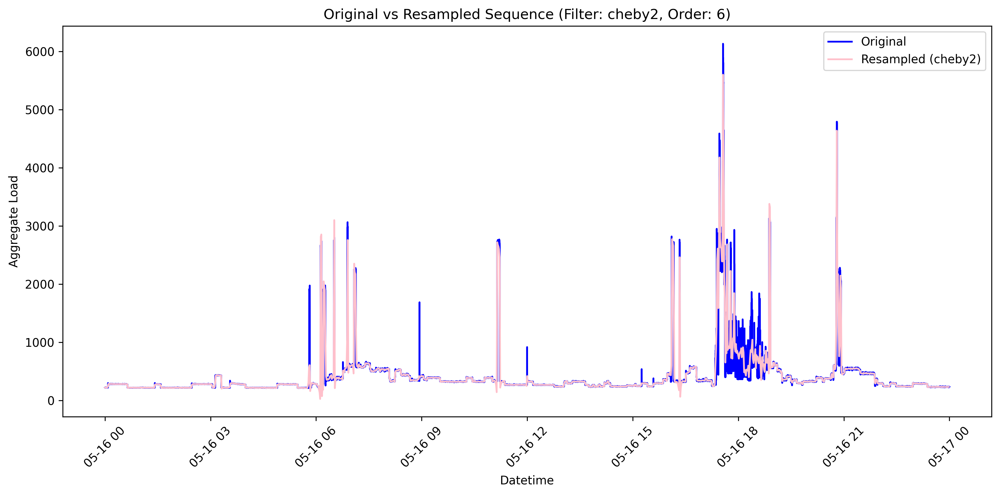

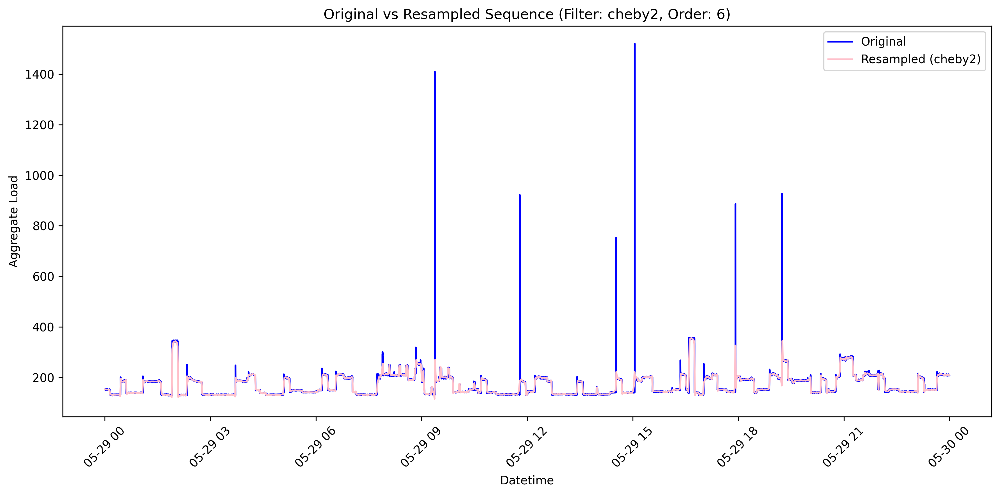

In [21]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_cheby2[idx], 'cheby2', 6)

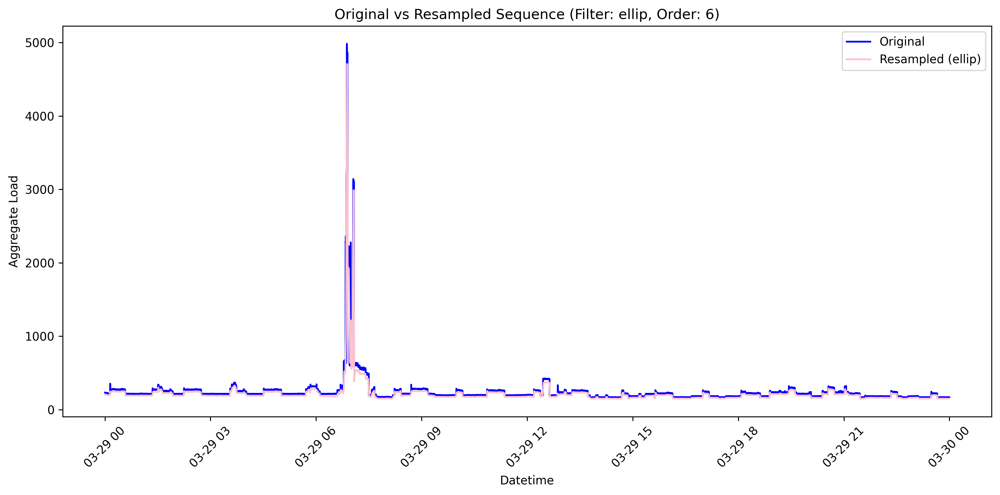

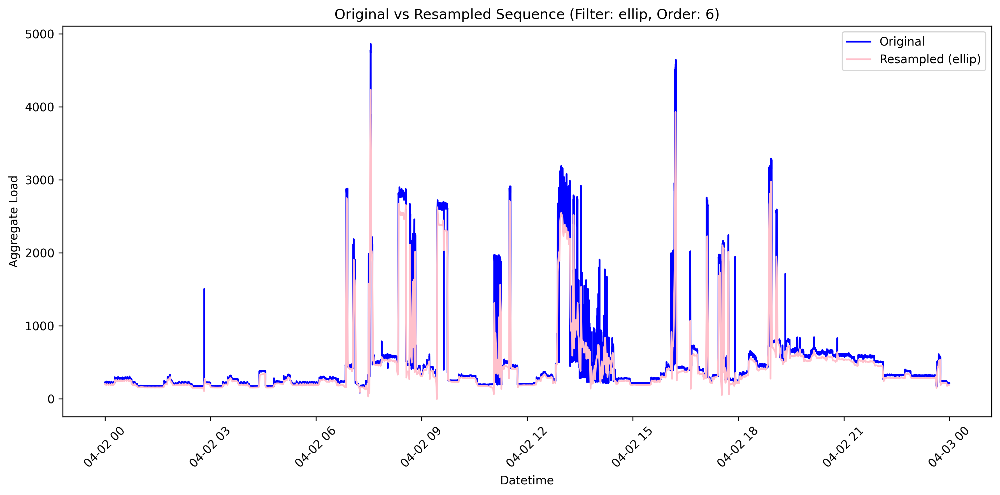

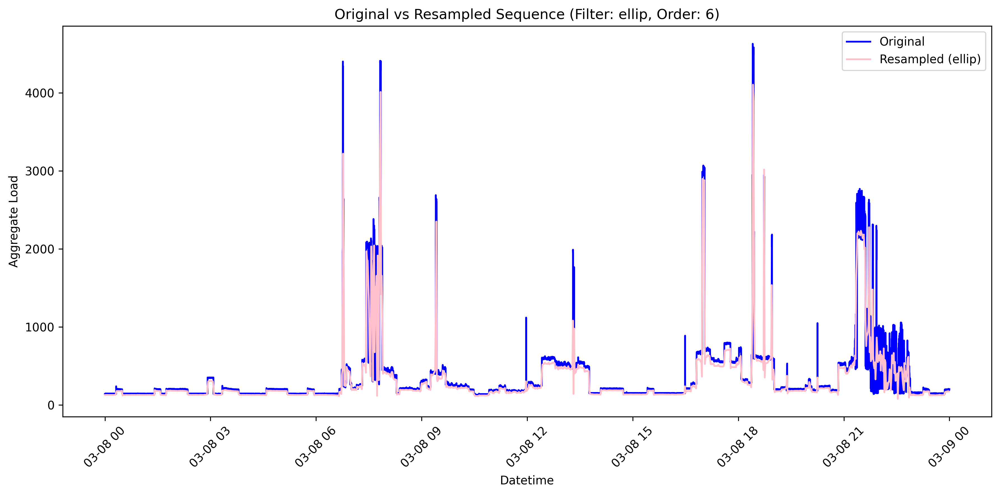

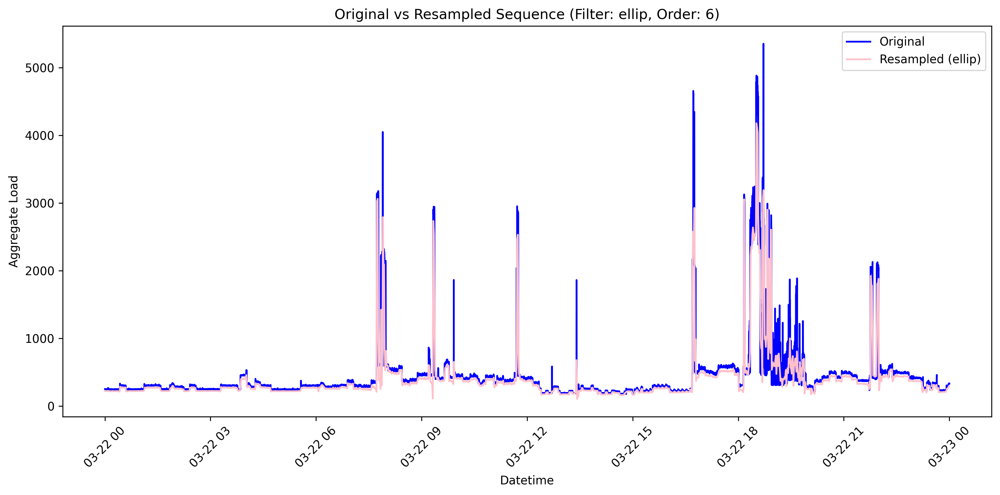

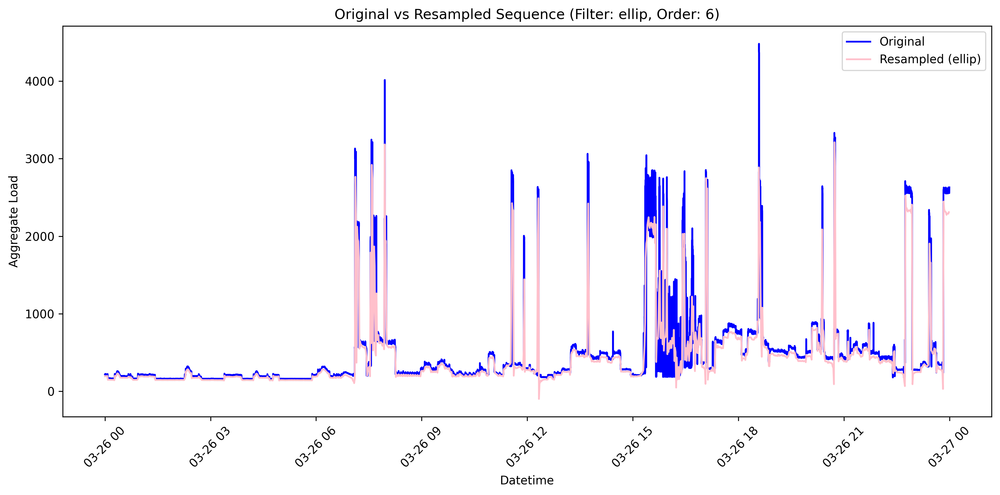

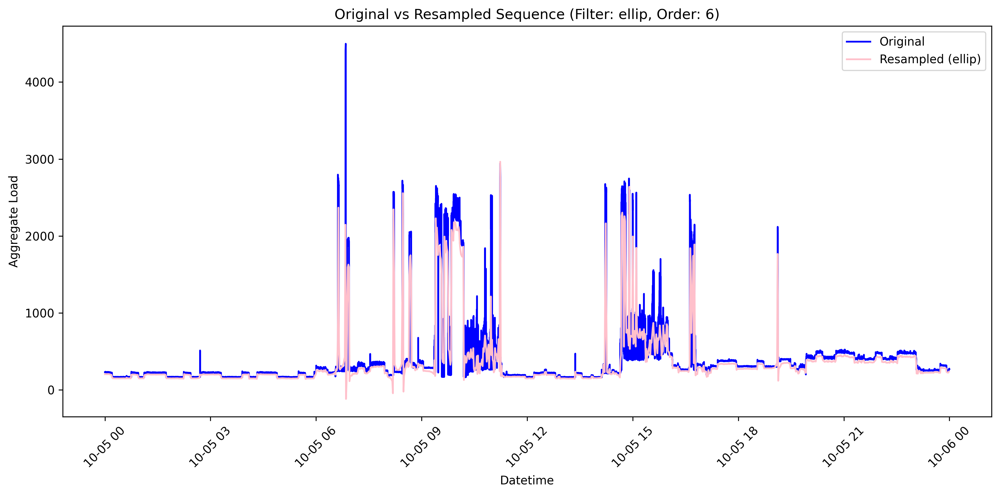

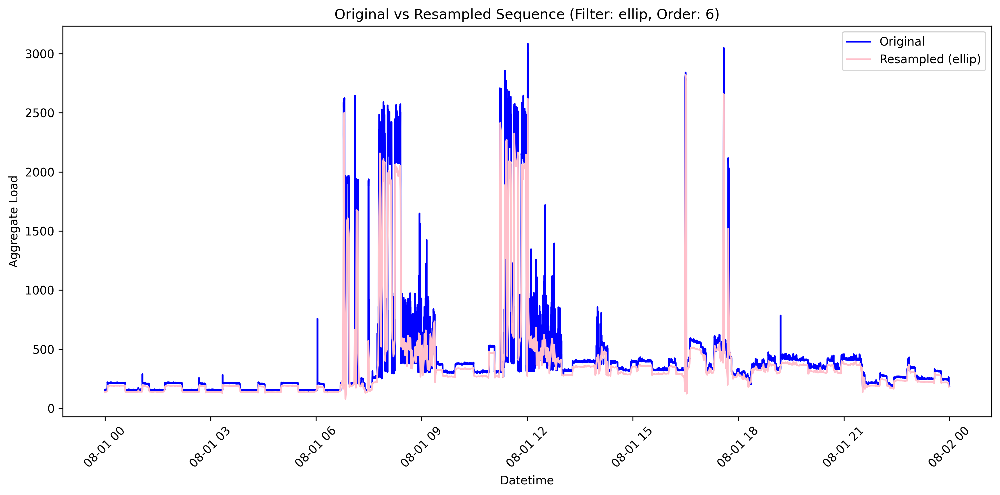

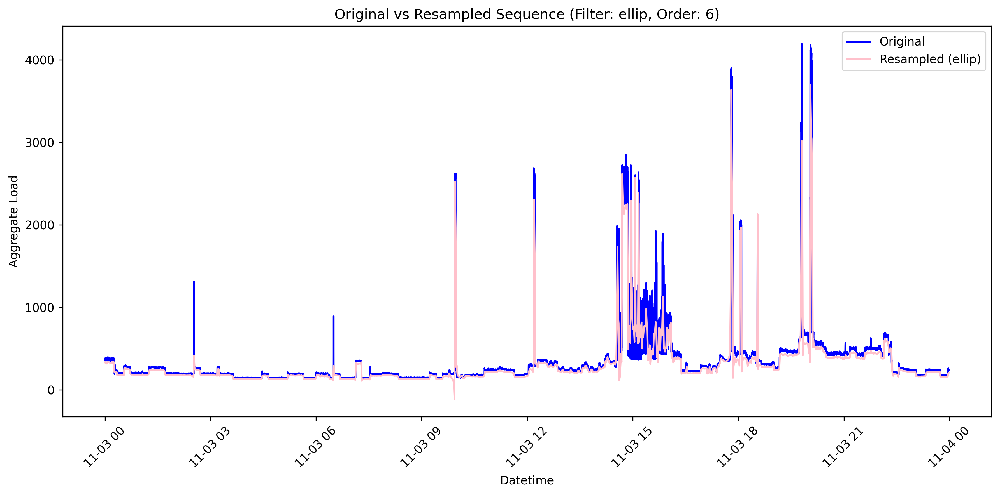

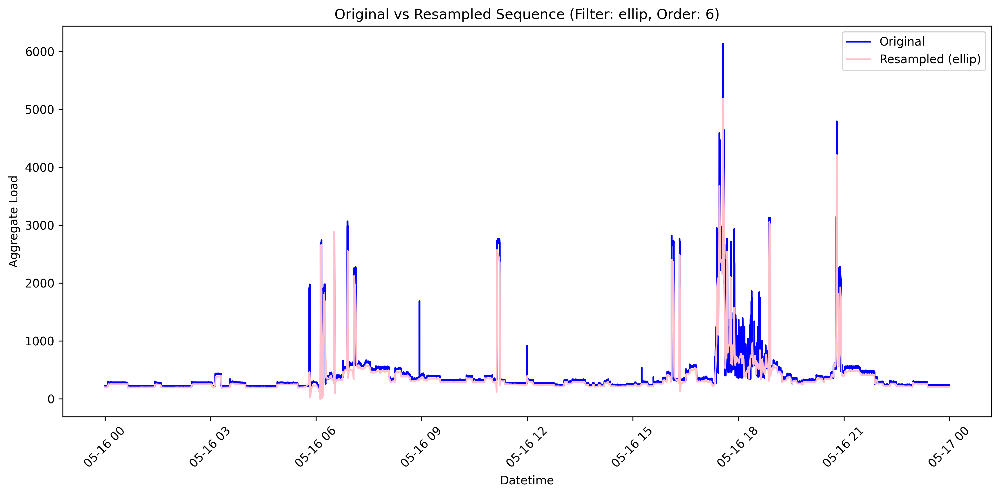

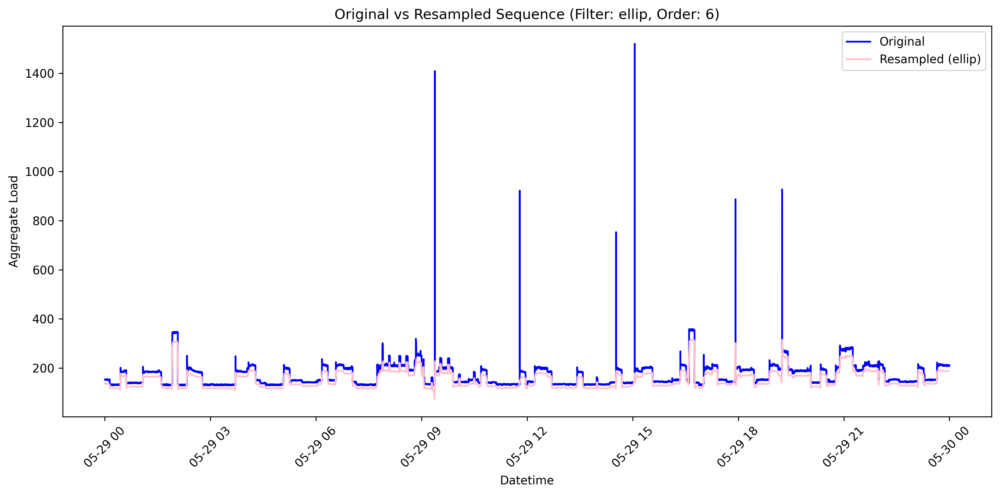

In [23]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_ellip[idx], 'ellip', 6)

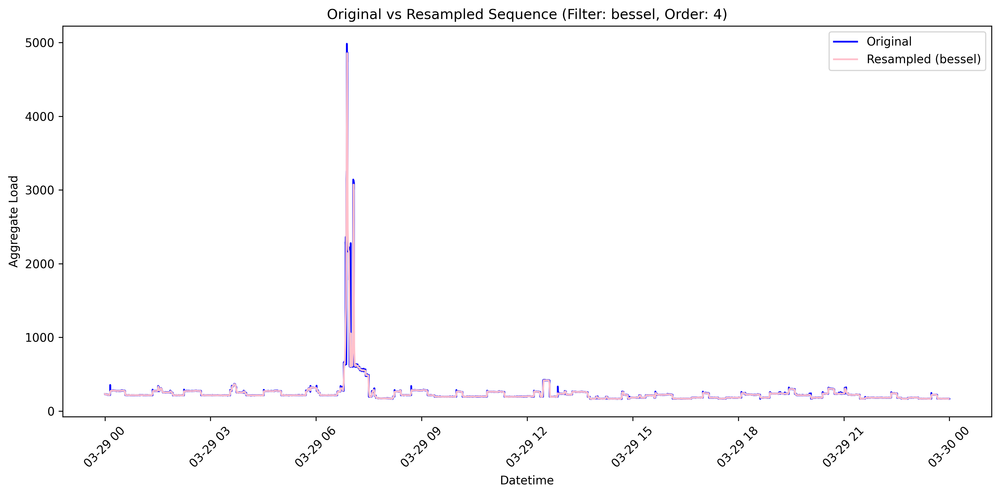

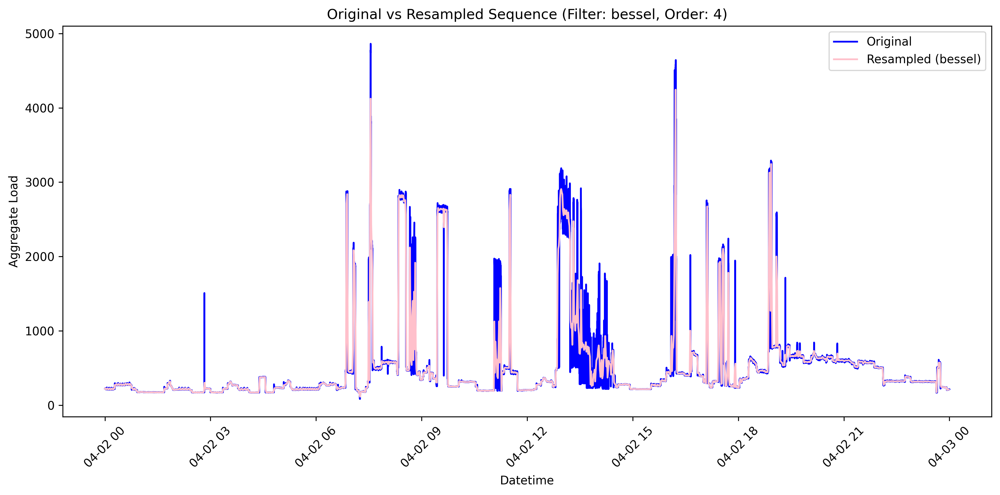

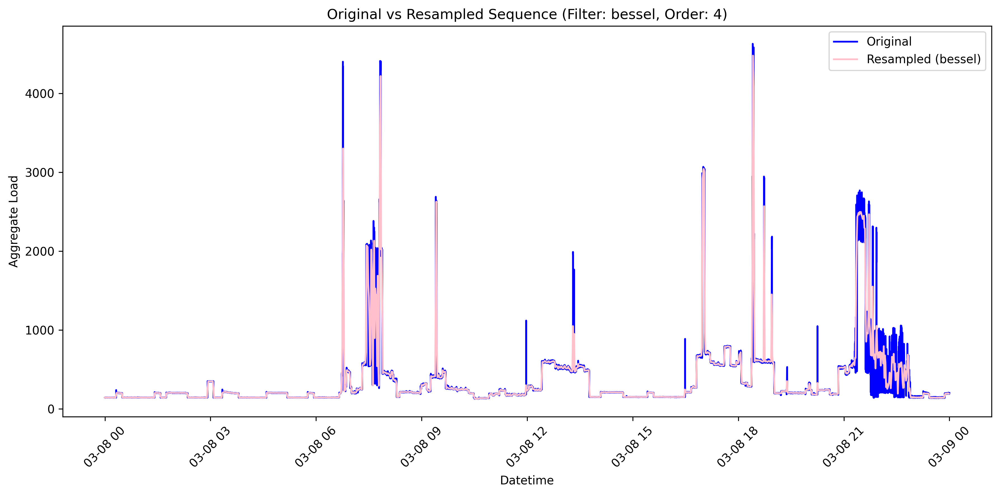

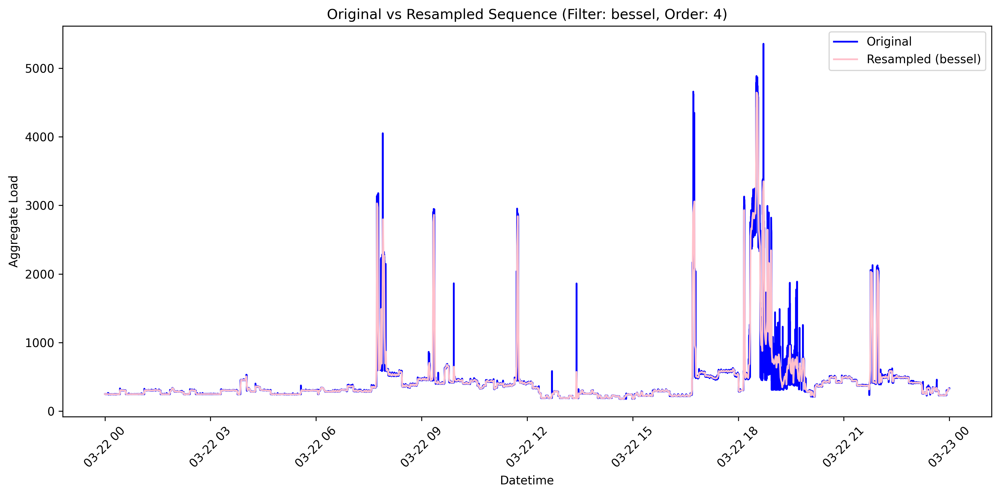

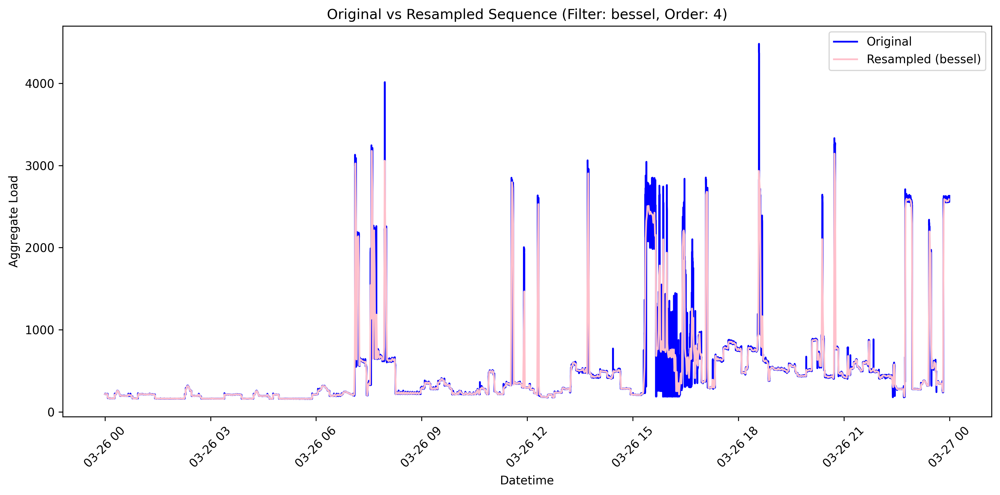

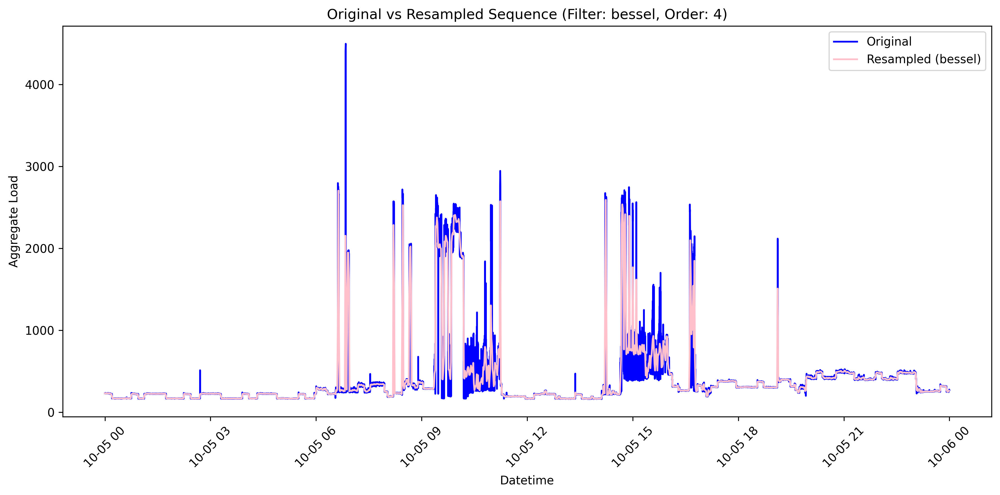

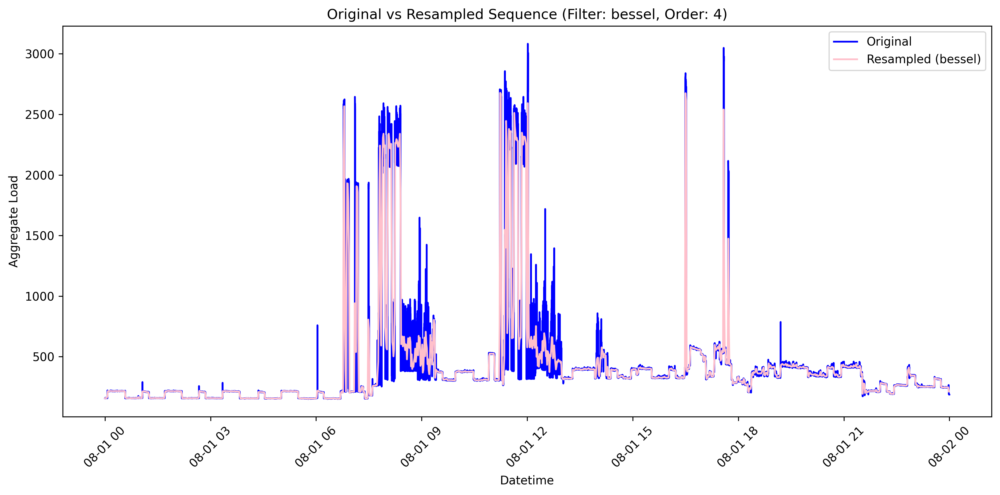

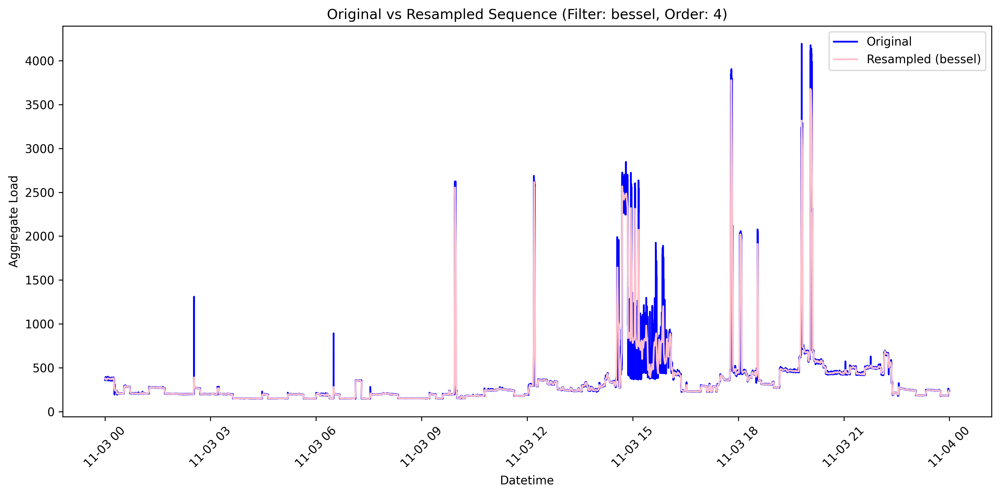

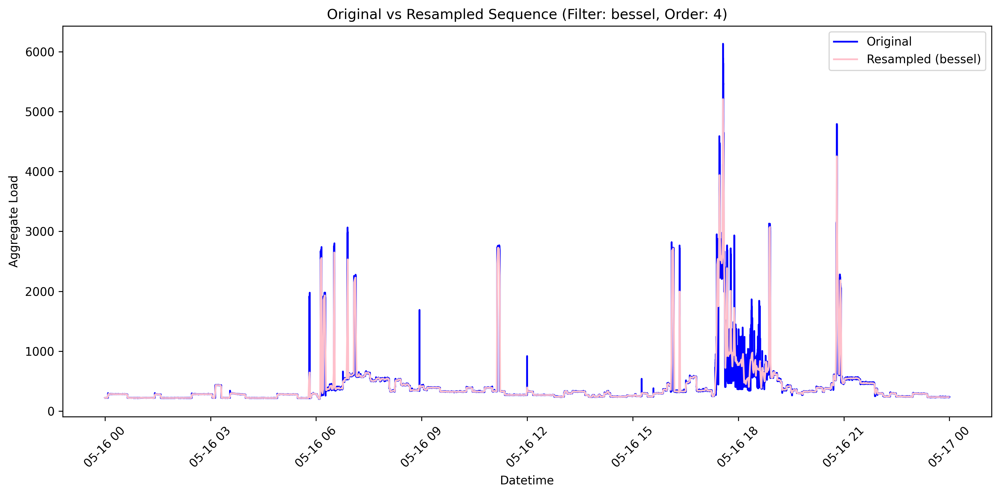

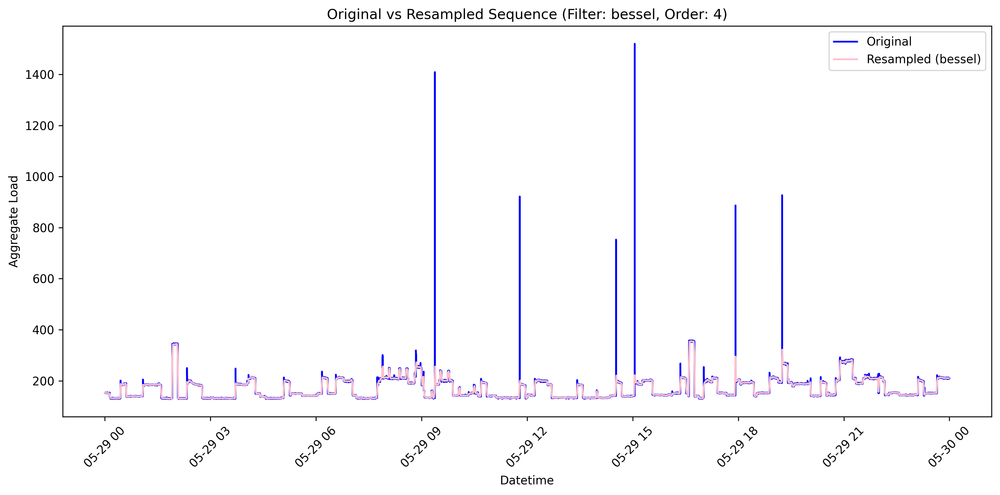

In [ ]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_bessel[idx], filter_type, filter_order)

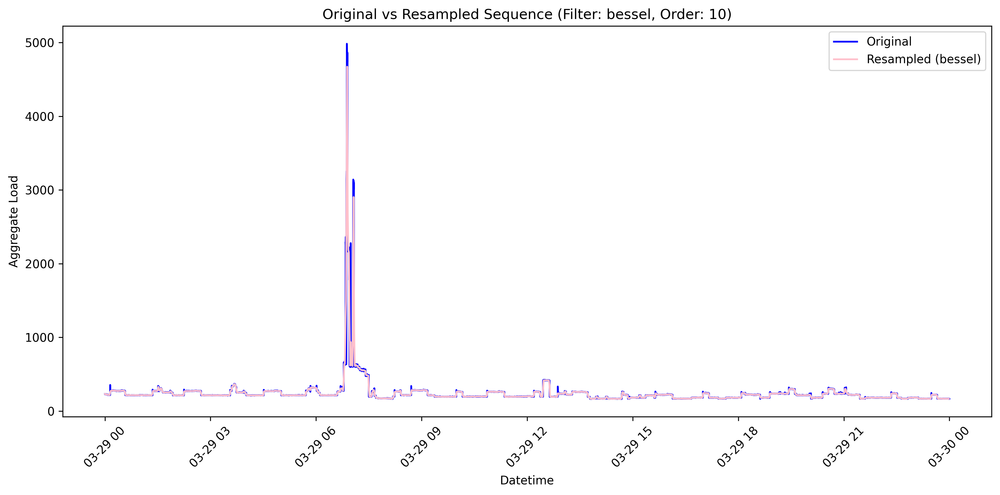

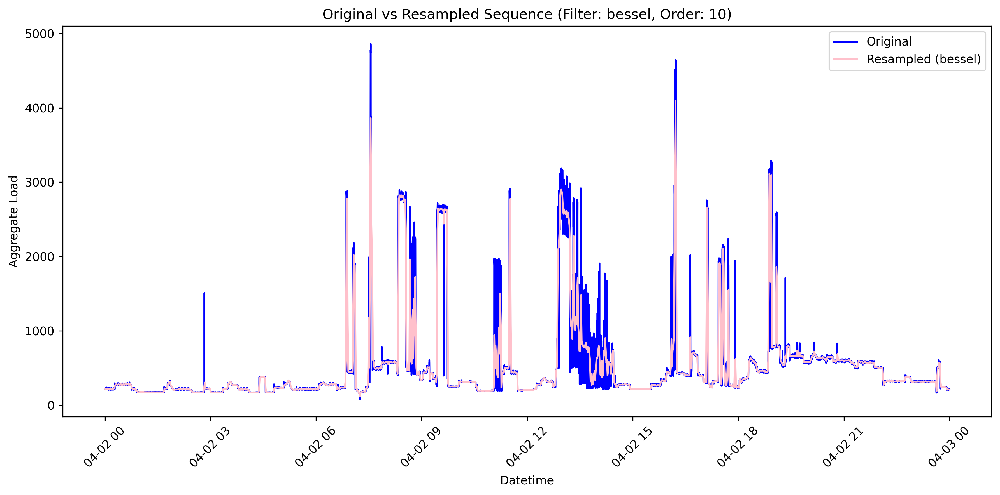

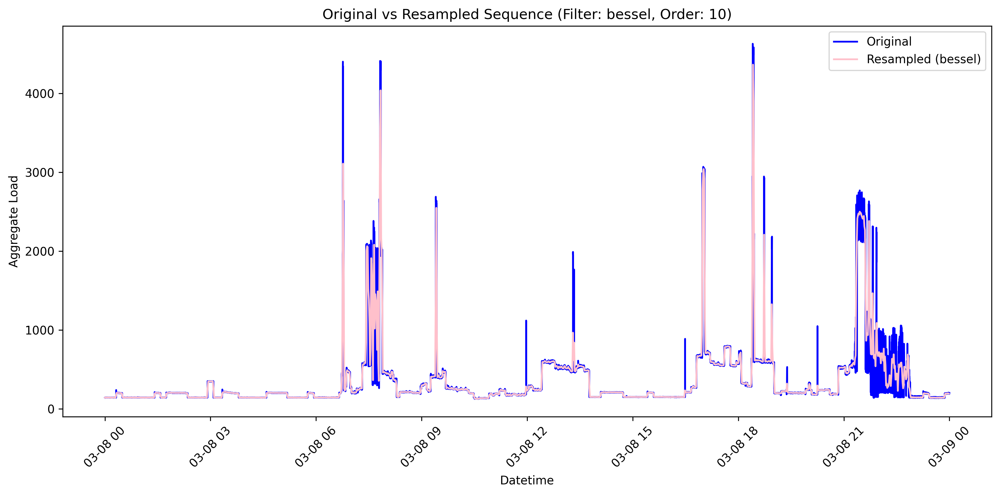

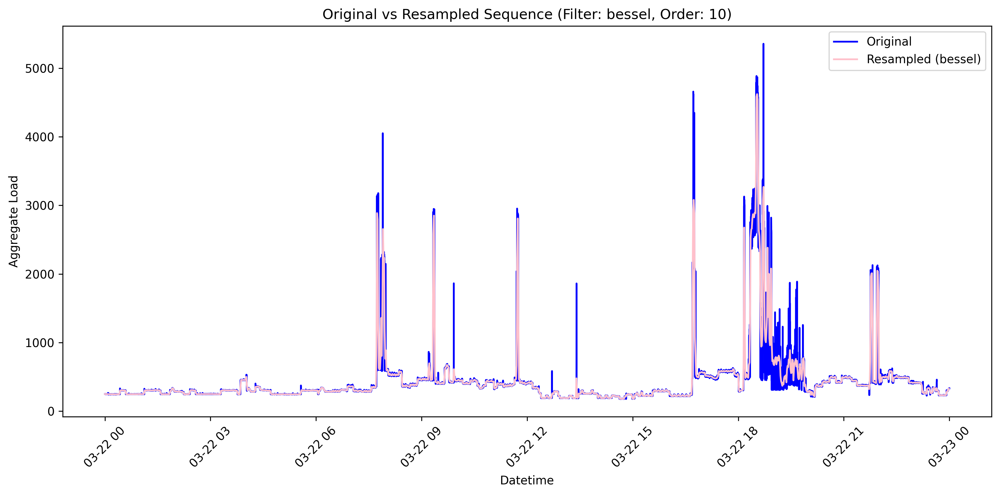

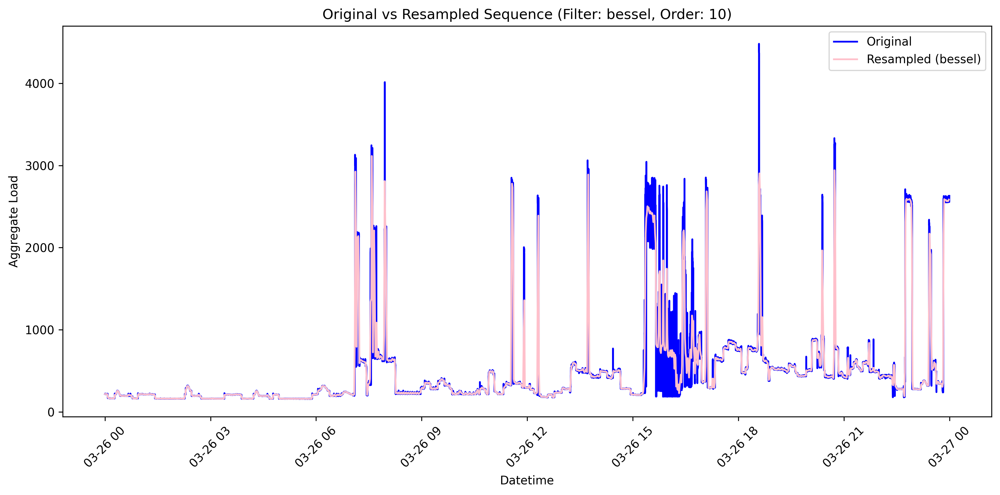

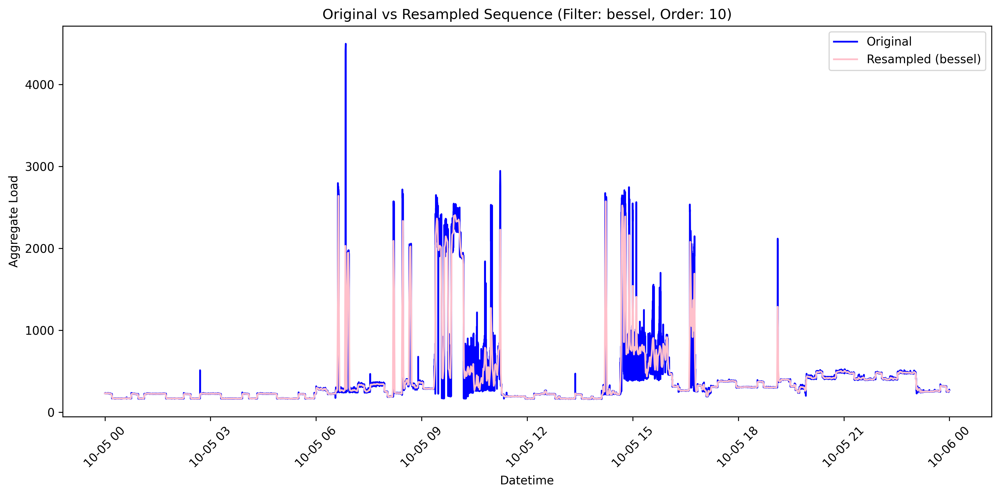

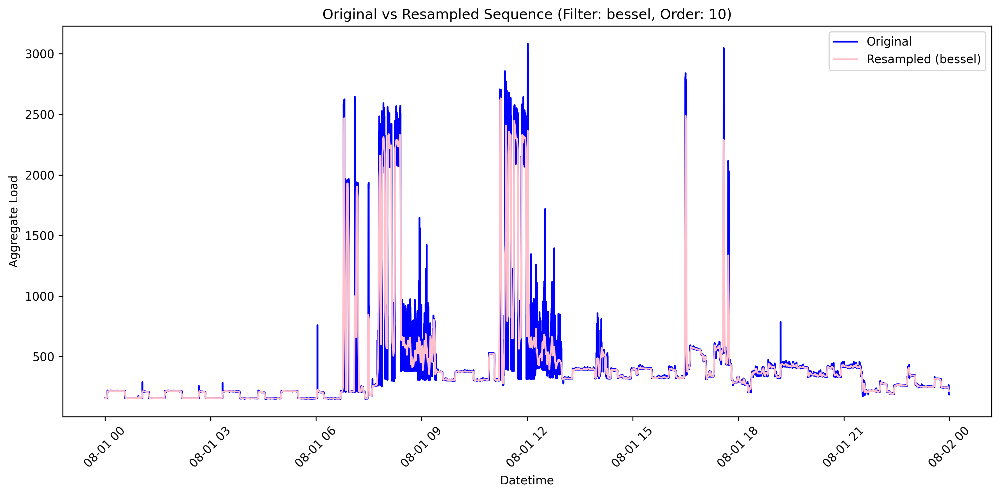

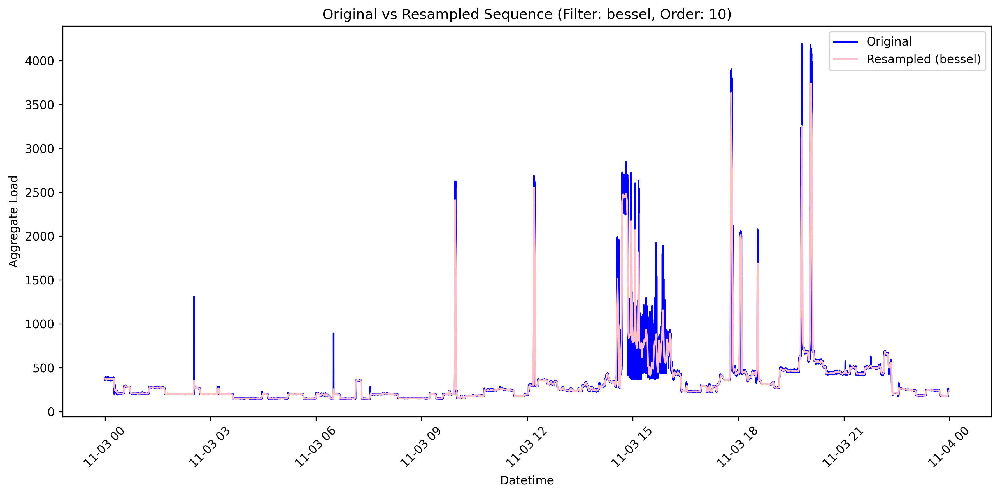

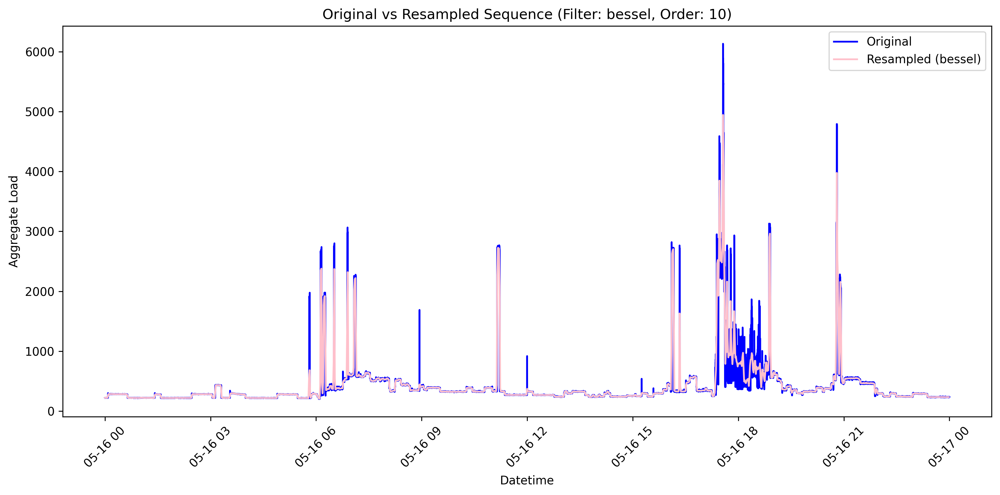

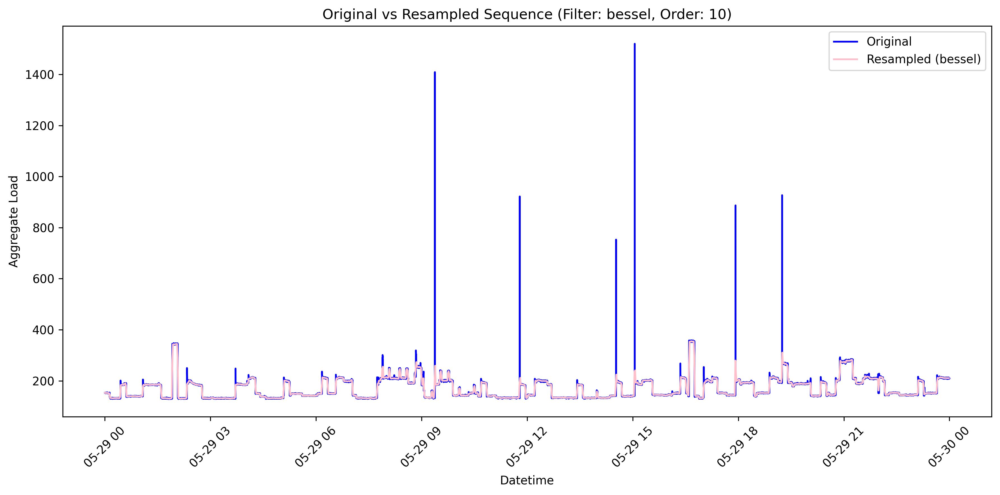

In [19]:
for i in selected_indices:
    idx = i
    plot_sequences_2(daily_sequences[idx], resampled_sequences_lpf_bessel[idx], 'bessel', 10)